## Library

In [1]:
import pandas as pd
import yfinance as yf
import numpy as np
import statsmodels.api as sm
import itertools
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import warnings
import statsmodels.formula.api as smf
import math

from datetime import date, datetime
from statsmodels.tsa.statespace.sarimax import SARIMAX

warnings.filterwarnings("ignore")
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

## Functions

In [2]:
def createPlot(assetDF, title, x, y):                  #funzione che crea un plot
    plt.figure(figsize = (20,9))
    plt.plot(assetDF)
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(y)
    plt.grid()
    plt.legend(assetDF.columns)

def createHist(assetDF, stocksString):                  #funzione che crea gli istogrammi dei rendimenti log
    plt.figure(figsize = (20,10))
    j=0
    for i in range(1, 7):
        plt.subplot(2, 6, i)
        assetDF[stocksString[j]].plot(grid=True, title='Rendimenti log di '+stocksString[j])
        plt.subplot(2, 6, i+6)
        plt.hist(assetDF[stocksString[j]], density = True)
        assetDF[stocksString[j]].plot.density()
        j+=1

def createDiagnosticGraph(assetDF, stocksString):           #funzione che crea i grafici diagnostici
    plt.figure(figsize = (20,5))
    plt.subplot(1, 4, 1)
    assetDF.plot(kind="hist")
    plt.title(assetDF.name)
    plt.subplot(1, 4, 2)
    assetDF.plot(kind="density")
    plt.title(assetDF.name)
    plt.subplot(1, 4, 3)
    assetDF.plot(kind="box")
    plt.title(assetDF.name)
    sm.qqplot(assetDF, line = 's')

def createScatterPlot(assetDF, title, stocksString):                   #funzione che crea uno scatter plot
    plt.figure(figsize = (25,13))
    z=1
    for i in range(len(stocksString)):
        for j in range(i+1, len(stocksString)):  
            plt.subplot(3, 5, z)
            plt.xlim(-1, 1)
            plt.ylim(-1, 1)
            plt.xlabel(stocksString[i])
            plt.ylabel(stocksString[j])
            plt.title(stocksString[i]+" "+stocksString[j])
            plt.scatter(assetDF[stocksString[i]], assetDF[stocksString[j]])
            z+=1

def addNameColumns(assetDF, name):          #funzione che aggiunge un suffisso al nome della colonna
    cols = assetDF.columns
    newCols = []
    for col in cols:
        newCols.append(col + "_" + name)
    assetDF.columns = newCols
    return assetDF

def removeNameColumns(assetDF, nameColumns, names):                    #funzione che rimuove un prefisso al nome della colonna
    columnsArray = []
    for name in names:
        columnsArray.append(nameColumns + "_" + name)
    assetDF = assetDF[columnsArray]
    cols = assetDF.columns
    newColumns = []
    for col in cols:
        newColumns.append(col.split("_")[1])
    assetDF.columns = newColumns
    return assetDF

def prodCumulativeReturn(cumulativeReturn):          #funzione che calcola i ritorni cumulati
    for i in cumulativeReturn:
        s = cumulativeReturn[i]
        prod = 1
        for j in s.index:
            number = s[j]
            if np.isnan(number) == False:
                prod *= number
                cumulativeReturn[i][j] = prod
    return cumulativeReturn

def createCorrelationTime(logReturn, stocksString):                 #funzione che calcola la correlazione nel tempo
    correlationAssets = dict()
    for stock in stocksString:
        correlationAssets[stock] = pd.DataFrame([])
    for i in range(3, len(logReturn) + 1):
        timeCorrelation = (logReturn.head(i).corr())
        for stock in stocksString:
            correlationAssets[stock] = correlationAssets[stock].append(timeCorrelation[stock])
    for stock in stocksString:
        correlationAssets[stock] = correlationAssets[stock].drop(stock, axis=1)
        correlationAssets[stock].index = logReturn.index[2:]
    return correlationAssets

def createPlotCorrelationTime(correlationAssets, stocksString):             #funzione che crea i plot delle correlazioni nel tempo
    for stock in stocksString:
        plt.figure(figsize = (20,9))
        plt.plot(correlationAssets[stock])
        plt.title(stock)
        plt.xlabel("Date")
        plt.ylabel("Correlation")
        plt.grid()
        plt.legend(correlationAssets[stock].columns)

def arima(assetDF, s):                      #funzione di arima
    p = d = q = range(2)
    param_combinations = list(itertools.product(p, d, q))
    lowest_aic, pdq, pdqs = None, None, None
    total_iterations = 0
    for order in param_combinations:
        for (p, q, d) in param_combinations:
            seasonal_order = (p, q, d, s)
            total_iterations += 1
            try:
                model = SARIMAX(assetDF, order=order, seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False, disp = False)
                model_result = model.fit(maxiter=200, disp=False)
                
                if not lowest_aic or model_result.aic < lowest_aic:
                    lowest_aic = model_result.aic
                    pdq, pdqs = order, seasonal_order
            
            except Exception as ex:
                continue
    return lowest_aic, pdq, pdqs

def createArimaxGraphs(closeMonthly, stock, lenTraining, model, predictionCi):              #funzione che crea i grafici di arima
    plt.figure(figsize=(12,6))
    ax = closeMonthly[stock].plot(label = 'Effettivo')
    predictionCi.plot(ax=ax, style = ['--', '--'], label = 'predicted/forecasted')
    ci_index = predictionCi.index
    lower_ci = predictionCi.iloc[:,0]
    upper_ci = predictionCi.iloc[:,1]
    ax.fill_between(ci_index, lower_ci, upper_ci, color = 'g', alpha = 0.1)
    ax.set_xlabel('Time (years)')
    ax.set_ylabel('Prezzo')
    plt.grid()
    plt.legend()
    plt.show()

def strategyMACD(assetDF, stocksString):                #funzione macd che mette nella colonna advice se vendere o comprare e che utilizza la position per vedere se sma30 è sopra sma 180 o viceversa
    for stock in stocksString:
        assetDF = assetDF.drop(columns = ['Open_'+stock, 'High_'+stock, 'Low_'+stock, 'Close_'+stock])
        assetDF['SMA30_'+stock] = assetDF['Adj Close_'+stock].rolling(30).mean()
        assetDF['SMA180_'+stock] = assetDF['Adj Close_'+stock].rolling(180).mean()
    for stock in stocksString:
        assetDF['Position_'+stock] = ["up" if assetDF.loc[i, 'SMA30_'+stock] > assetDF.loc[i, 'SMA180_'+stock] else "down" for i in assetDF.index]
        assetDF.dropna()
    for stock in stocksString:
        a = False                        
        for i in assetDF.index:
            if a == False:
                a = assetDF.loc[i, 'Position_'+stock]
                for stock_nil in stocksString:
                    assetDF.loc[i, 'Advice_'+stock_nil] = "-"
            else:
                if a != assetDF.loc[i, 'Position_'+stock] and a == "down":
                    assetDF.loc[i, 'Advice_'+stock] = "buy"
                elif a != assetDF.loc[i, 'Position_'+stock] and a == "up":
                    assetDF.loc[i, 'Advice_'+stock] = "sell"
                else:
                    assetDF.loc[i, 'Advice_'+stock] = "-"
                a = assetDF.loc[i, 'Position_'+stock]
    return assetDF

def createGraphStrategy(assetDF, stock):                #funzione che crea il grafico della strategia macd               
    plt.figure(figsize=(16,9))
    ax1 = plt.subplot2grid((7,1), (0,0), rowspan = 4, colspan = 1, title = stock)
    ax2 = plt.subplot2grid((7,1), (5,0), rowspan = 2, colspan = 1, sharex = ax1)
    ax1.plot(assetDF['Adj Close_'+stock], label = 'Price')
    ax1.plot(assetDF['SMA30_'+stock], label = 'SMA30')
    ax1.plot(assetDF['SMA180_'+stock], label = 'SMA180')
    ax2.bar(assetDF.index, assetDF['Volume_'+stock], label = 'Volume_'+stock)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax2.set_xlabel('Data (Year - month)')
    ax1.legend()
    ax2.legend()

def strategyPerformance(assetDF, stocksString):             
    for stock in stocksString:    
        assetDF['Price_yesterday_'+stock] = assetDF['Adj Close_'+stock].shift(1)
        assetDF['Change_'+stock] = assetDF['Adj Close_'+stock] / assetDF['Price_yesterday_'+stock]
        assetDF['Invested_SMA_'+stock] = [1 if assetDF.loc[i, 'SMA30_'+stock] > assetDF.loc[i, 'SMA180_'+stock] 
                                else 0 for i in assetDF.index]
    for stock in stocksString:
        sma = assetDF[assetDF['Invested_SMA_'+stock] == 1]
    for stock in stocksString:    
        sma['Return_'+stock] = np.cumprod(sma['Change_'+stock])
    for stock in stocksString:    
        sma['rtn'+stock] = sma['Return_'+stock].pct_change()
    for stock in stocksString:    
        sma['rtn'+stock].std()*np.sqrt(252)
    for stock in stocksString:    
        sma['rtn'+stock].mean()*252 / (sma['rtn'+stock].std()*np.sqrt(252))
    return assetDF, sma

def createGraphStrategyEfficiencyBuyHold(assetDF, sma, stocksString):               #funzione che valuta la strategia comparondala con buy and hold
    for stock in stocksString:
        assetDF['Buy_and_hold_'+stock] = np.cumprod(assetDF['Change_'+stock])
        assetDF['rtn_'+stock] = assetDF['Buy_and_hold_'+stock].pct_change()
        assetDF['rtn_'+stock].std()
        assetDF['rtn_'+stock].mean()*252 / (assetDF['rtn_'+stock].std()*np.sqrt(252))
        plt.figure(figsize=(16,9))
        ax1 = plt.subplot2grid((10,1), (0,0), rowspan = 4, colspan = 1, title = stock)
        ax2 = plt.subplot2grid((10,1), (5,0), rowspan = 2, colspan = 1, sharex = ax1)
        ax3 = plt.subplot2grid((10,1), (8,0), rowspan = 2, colspan = 1, sharex = ax1)
        ax1.plot(assetDF['Adj Close_'+stock], label = 'Price_'+stock)
        ax1.plot(assetDF['SMA30_'+stock], label = 'SMA30_'+stock)
        ax1.plot(assetDF['SMA180_'+stock], label = 'SMA180_'+stock)
        ax2.bar(assetDF.index, assetDF['Volume_'+stock], label = 'Volume_'+stock)
        ax3.plot(assetDF['Buy_and_hold_'+stock], label = 'Buy and hold_'+stock)
        ax3.plot(sma['Return_'+stock], label = 'SMA_'+stock)
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
        ax3.set_xlabel('Date (Year - month)')
        ax1.legend()
        ax2.legend()
        ax3.legend()
        plt.show()
        assetDF['Buy_and_hold_'+stock][-1]
        sma['Return_'+stock][-1]
        assetDF['EWM12_'+stock] = assetDF['Adj Close_'+stock].ewm(span=12, adjust=False).mean()
        assetDF['EWM26_'+stock] = assetDF['Adj Close_'+stock].ewm(span=26, adjust=False).mean()
        assetDF['Invested_EWM_'+stock] = [1 if assetDF.loc[i, 'EWM12_'+stock] > assetDF.loc[i, 'EWM26_'+stock] 
                                else 0 for i in assetDF.index]
        ewm = assetDF[assetDF['Invested_EWM_'+stock] == 1]
        ewm['Return_'+stock] = np.cumprod(ewm['Change_'+stock])

def capmBeta(closeMonthly, market, stocksString):
    covariance = dict()
    beta = dict()
    market = market.groupby(pd.Grouper(freq='M')).last()
    market = market.rename(columns={"Adj Close":"^GSPC"})
    g = closeMonthly.join(market['^GSPC'])
    g = g/g.shift(1)
    g = g.dropna()
    cov = g.cov()
    benchmark = g['^GSPC'].var()
    i=0
    for stock in stocksString:
        covariance[stock] = cov.iloc[i, 6]
        i+=1
        beta[stock] = covariance[stock] / benchmark
    return beta

def createvixString(stocksString):                  #creo un vettore con i nomi string degli asset + quello di VIX
    vixString = []
    for stock in stocksString:
        vixString.append("Adj Close_"+stock)
    vixString.append("Adj Close_VIX")
    return vixString
    
def createAdjCloseVixAsset(vix, stocks, vixString):             #unisco in unico dataframe le adj close degli asset piu quella di VIX
    vixAsset = vix.join(stocks, lsuffix="Vix")
    vixAsset = vixAsset.rename(columns={"Adj Close":"Adj Close_VIX"})
    vixAsset = vixAsset[vixString]
    return vixAsset

def createVixGraph(vixLog, stocksString):                   #crea gli scatter con dentro VIX
    for stock in stocksString:
        pd.plotting.scatter_matrix(vixLog[["Adj Close_"+stock, "Adj Close_VIX"]], alpha=0.5, diagonal = 'hist', hist_kwds={'bins': 50}, figsize = (19,9), grid = True)

def createScatterPlotVix(vixLog, stocksString):             #crea i plot con dentro VIX
    vixLog = vixLog.dropna()
    for stock in stocksString:
        reg = np.polyfit(vixLog['Adj Close_'+stock], vixLog['Adj Close_VIX'], deg=1)  
        ax = vixLog.plot(kind='scatter', x='Adj Close_'+stock, y='Adj Close_VIX', figsize=(19,8))
        ax.plot(vixLog['Adj Close_'+stock], np.polyval(reg, vixLog['Adj Close_'+stock]), 'r', lw=2)

def createPortfolioReturn(simpleReturnMontly, simpleReturnMontlyMeans, covarianceMatrix, numberPortfolios, rf):
    portfolioReturns = []
    portfolioRisks = []
    sharpeRatios = []
    portfolioWeights = []
    
    for portfolio in range(numberPortfolios):
        weights = np.random.random_sample(len(simpleReturnMontly.columns))
        weights = np.round((weights / np.sum(weights)), 3)
        portfolioWeights.append(weights)
        annualizedReturn = (np.sum(simpleReturnMontlyMeans * weights))
        portfolioReturns.append(annualizedReturn)
        portfolioVariance = np.dot(weights.T, np.dot(covarianceMatrix, weights))
        portfolioStandardDeviation = np.sqrt(portfolioVariance)
        portfolioRisks.append(portfolioStandardDeviation)
        sharpeRatio = (annualizedReturn - rf) / portfolioStandardDeviation
        sharpeRatios.append(sharpeRatio)

    portfolioReturns = np.array(portfolioReturns)
    portfolioRisks = np.array(portfolioRisks)
    sharpeRatios = np.array(sharpeRatios)

    portfolioMetrics = [portfolioReturns, portfolioRisks, sharpeRatios, portfolioWeights]
    portfoliosDf = pd.DataFrame(portfolioMetrics).T
    portfoliosDf.columns = ['Return', 'Risk', 'Sharpe', 'Weights']

    minRisk = portfoliosDf.iloc[portfoliosDf['Risk'].astype(float).idxmin()]
    highestReturn = portfoliosDf.iloc[portfoliosDf['Return'].astype(float).idxmax()]
    highestSharpe = portfoliosDf.iloc[portfoliosDf['Sharpe'].astype(float).idxmax()]
    return portfolioRisks, portfolioReturns, minRisk, highestReturn, highestSharpe

def createPortfolioReturnPlot(portfolioRisks, portfolioReturns, rf, variant, minRisk, highestReturn, highestSharpe):
    plt.figure(figsize = (10,5))
    plt.scatter(portfolioRisks, portfolioReturns, c = (portfolioReturns - rf)/ portfolioRisks)
    plt.title('Portfolio optimization - '+ variant +' returns', fontsize = 20)
    plt.xlabel('Volatility', fontsize = 18)
    plt.ylabel('Return', fontsize = 18)
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    plt.colorbar(label = 'Sharpe ratio')
    plt.plot(minRisk.Risk, minRisk.Return, marker="*", markersize=10, markeredgecolor="red", markerfacecolor="orange")
    plt.plot(highestReturn.Risk, highestReturn.Return, marker="*", markersize=10, markeredgecolor="red", markerfacecolor="orange")
    plt.plot(highestSharpe.Risk, highestSharpe.Return, marker="*", markersize=10, markeredgecolor="red", markerfacecolor="orange")
    plt.show()
    

## Creation Dataframe asset

In [3]:
startDate = '2012-11-30'
endDate = '2022-11-30'

stocksString = ["EXXONMOBIL", "CHEVRON", "NVIDIA", "AMD", "NETFLIX", "DISNEY"]
stocksTicker = ["XOM", "CVX", "NVDA", "AMD", "NFLX", "DIS"]

rf = 0.02

downloads = []
stocks = pd.DataFrame([])

for i in range(len(stocksString)):
    stock = yf.download(stocksTicker[i], startDate, endDate)
    stock = addNameColumns(stock, stocksString[i])
    downloads.append(stock)
for stock in downloads:
    stocks = pd.concat([stocks, stock], axis=1)

market = yf.download('^GSPC', startDate, endDate)
frenchFactor = pd.read_csv('F-F_Research_Data_Factors.CSV', skiprows=3)
vix = yf.download(['^VIX'], startDate, endDate)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


## Data presentation

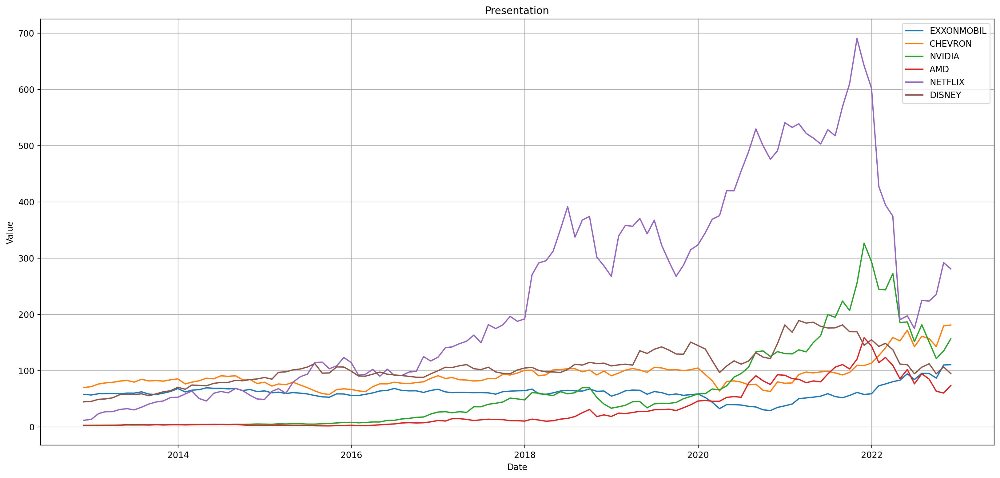

In [4]:
closeMonthly = removeNameColumns(stocks, "Adj Close", stocksString)
closeMonthly  = closeMonthly.groupby(pd.Grouper(freq='M')).last()
createPlot(closeMonthly, "Presentation", "Date", "Value")

## Returns

### Cumulative return

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2013,1.201184,1.193086,1.335237,1.612500,3.976347,1.553388
2014,1.128441,1.109703,1.701036,1.112500,3.689491,1.939441
2015,0.984093,0.930257,2.842697,1.195833,8.647370,2.190208
2016,1.179752,1.271302,9.294489,4.725000,9.359542,2.204926
2017,1.134840,1.405928,16.914845,4.283333,14.512582,2.309885
2018,0.963555,1.268886,11.702496,7.691666,20.235662,2.393221
2019,1.033247,1.462692,20.706751,19.108333,24.462577,3.195273
2020,0.659098,1.083093,46.030205,38.212498,40.880330,4.002763
2021,1.038577,1.583929,103.789856,59.958328,45.545738,3.421945


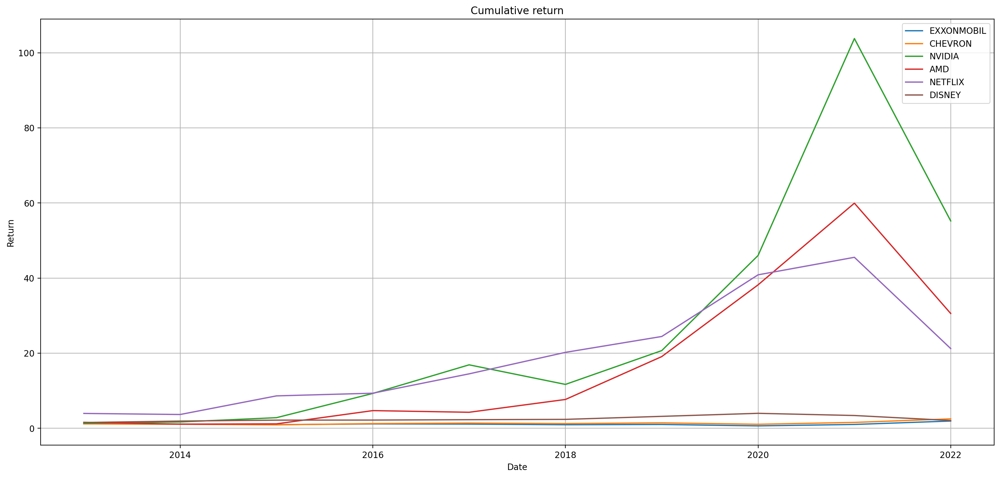

In [5]:
cumulativeReturn = removeNameColumns(stocks, "Adj Close", stocksString)
cumulativeReturn = cumulativeReturn.groupby(pd.Grouper(freq='Y')).last()
cumulativeReturn = cumulativeReturn/cumulativeReturn.shift(1)
cumulativeReturn = prodCumulativeReturn(cumulativeReturn)
cumulativeReturn.index = cumulativeReturn.index.year
cumulativeReturn = cumulativeReturn.dropna()
createPlot(cumulativeReturn, "Cumulative return", "Date", "Return")
cumulativeReturn

### Composite return

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2013,0.044075,0.135380,0.167600,0.416168,1.772987,0.273337
2014,0.104542,0.036666,0.332738,0.083909,0.630058,0.359958
2015,-0.122487,-0.169714,0.301383,-0.363270,0.598321,0.296102
2016,0.078743,0.087557,1.298817,1.253642,0.110285,-0.084507
2017,-0.016294,0.161007,1.801225,1.361915,0.620834,0.107656
2018,0.015472,0.120082,0.555525,0.386961,0.930713,0.035366
2019,-0.037166,0.034844,-0.245899,0.739294,0.030010,0.224596
2020,-0.360932,-0.228060,1.272531,1.191629,0.358665,-0.025129
2021,0.406104,0.249955,0.976096,0.541394,0.249292,0.391483


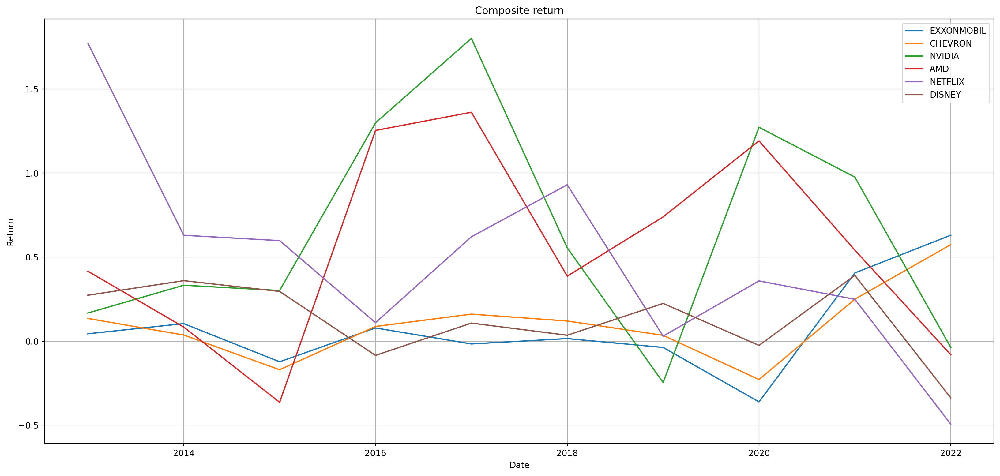

In [6]:
compositeReturn = removeNameColumns(stocks, "Adj Close", stocksString)
compositeReturn = compositeReturn.groupby(pd.Grouper(freq='Y')).mean()
compositeReturn = (compositeReturn/compositeReturn.shift(1))-1
compositeReturn.index = compositeReturn.index.year
compositeReturn = compositeReturn.dropna()
createPlot(compositeReturn, "Composite return", "Date", "Return")
compositeReturn

### Simple Return


,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2013,1.201184,1.193086,1.335237,1.612500,3.976347,1.553388
2014,0.939441,0.930111,1.273958,0.689923,0.927859,1.248523
2015,0.872082,0.838294,1.671156,1.074906,2.343784,1.129299
2016,1.198821,1.366614,3.269603,3.951220,1.082357,1.006720
2017,0.961931,1.105896,1.819879,0.906526,1.550565,1.047602
2018,0.849067,0.902526,0.691848,1.795720,1.394353,1.036078
2019,1.072329,1.152737,1.769430,2.484291,1.208884,1.335135
2020,0.637890,0.740479,2.222956,1.999782,1.671138,1.252714
2021,1.575755,1.462413,2.254821,1.569076,1.114124,0.854896


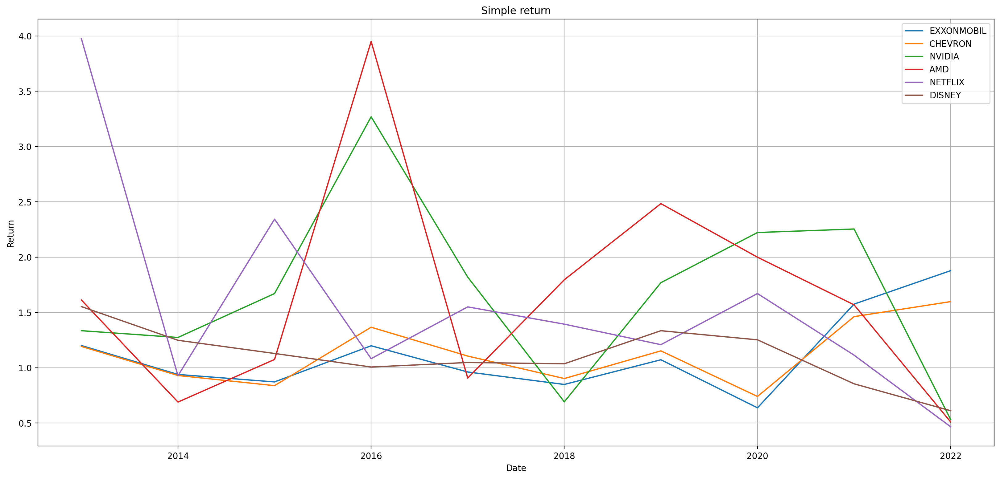

In [7]:
simpleReturn = removeNameColumns(stocks, "Adj Close", stocksString)
simpleReturn = simpleReturn.groupby(pd.Grouper(freq='Y')).last()
simpleReturn = simpleReturn/simpleReturn.shift(1)
simpleReturn.index = simpleReturn.index.year
simpleReturn = simpleReturn.dropna()
createPlot(simpleReturn, "Simple return", "Date", "Return")
simpleReturn

### Log return

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2013,0.183308,0.176543,0.289109,0.477786,1.380364,0.440439
2014,-0.062471,-0.072451,0.242128,-0.371176,-0.074875,0.221961
2015,-0.136872,-0.176387,0.513516,0.072233,0.851767,0.121597
2016,0.181339,0.312336,1.184668,1.374024,0.079141,0.006697
2017,-0.038813,0.100656,0.598770,-0.098136,0.438620,0.046504
2018,-0.163617,-0.102558,-0.368390,0.585406,0.332430,0.035443
2019,0.069833,0.142139,0.570658,0.909987,0.189698,0.289032
2020,-0.449590,-0.300458,0.798838,0.693038,0.513505,0.225312
2021,0.454735,0.380088,0.813070,0.450487,0.108068,-0.156776


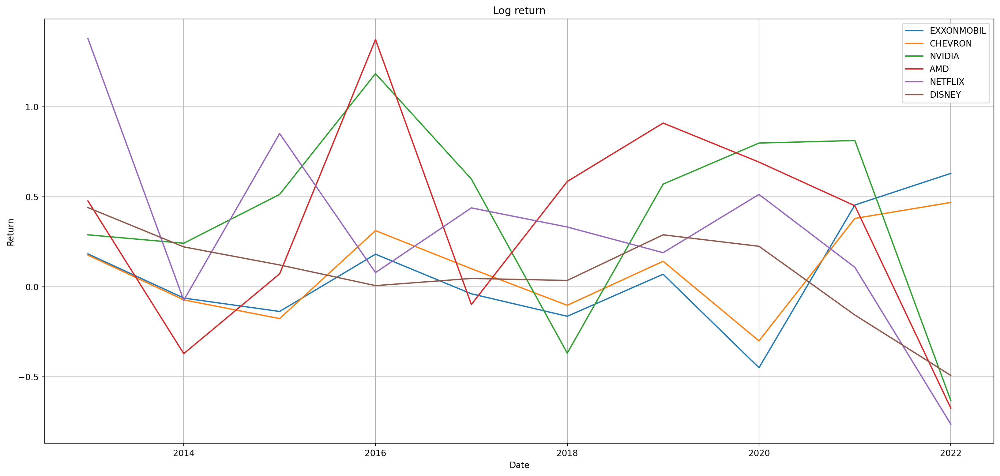

In [8]:
logReturn = removeNameColumns(stocks, "Adj Close", stocksString)
logReturn = logReturn.groupby(pd.Grouper(freq='Y')).last()
logReturn = np.log(logReturn/logReturn.shift(1))
logReturn.index = logReturn.index.year
logReturn = logReturn.dropna()
createPlot(logReturn, "Log return", "Date", "Return")
logReturn

## Histograms

### Log return histogram

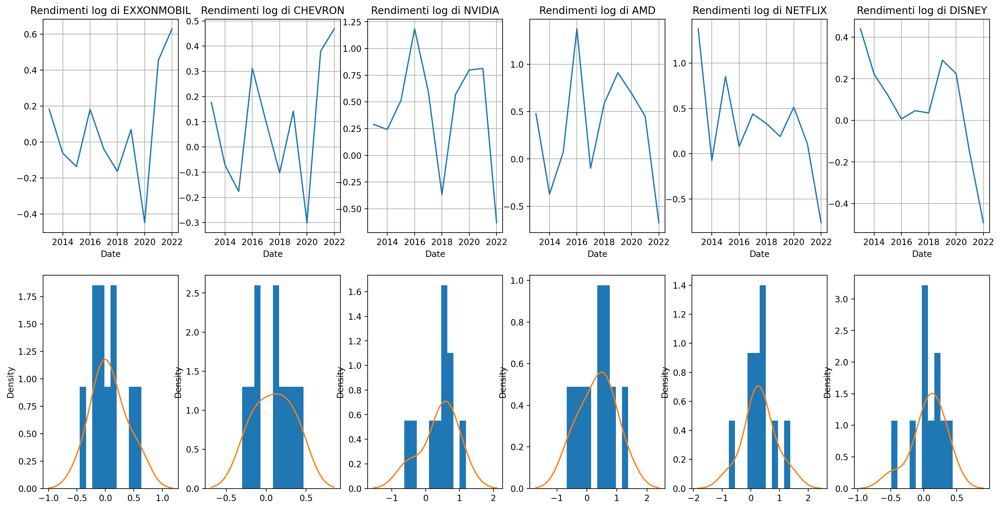

In [9]:
createHist(logReturn, stocksString)

## Diagnostic graph

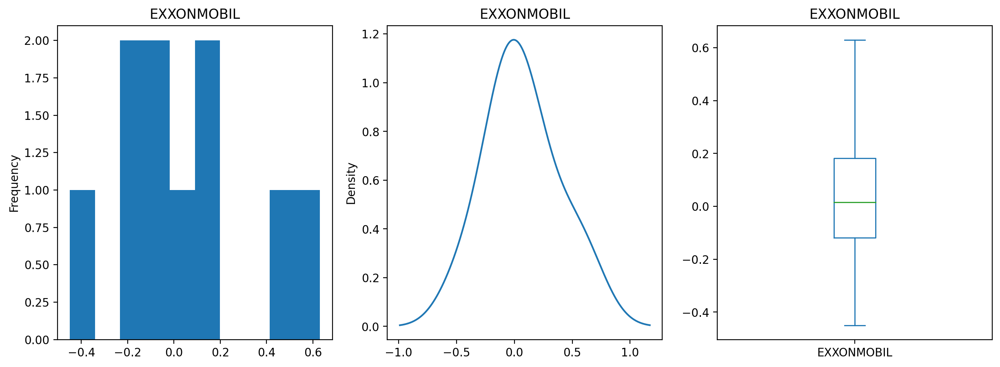

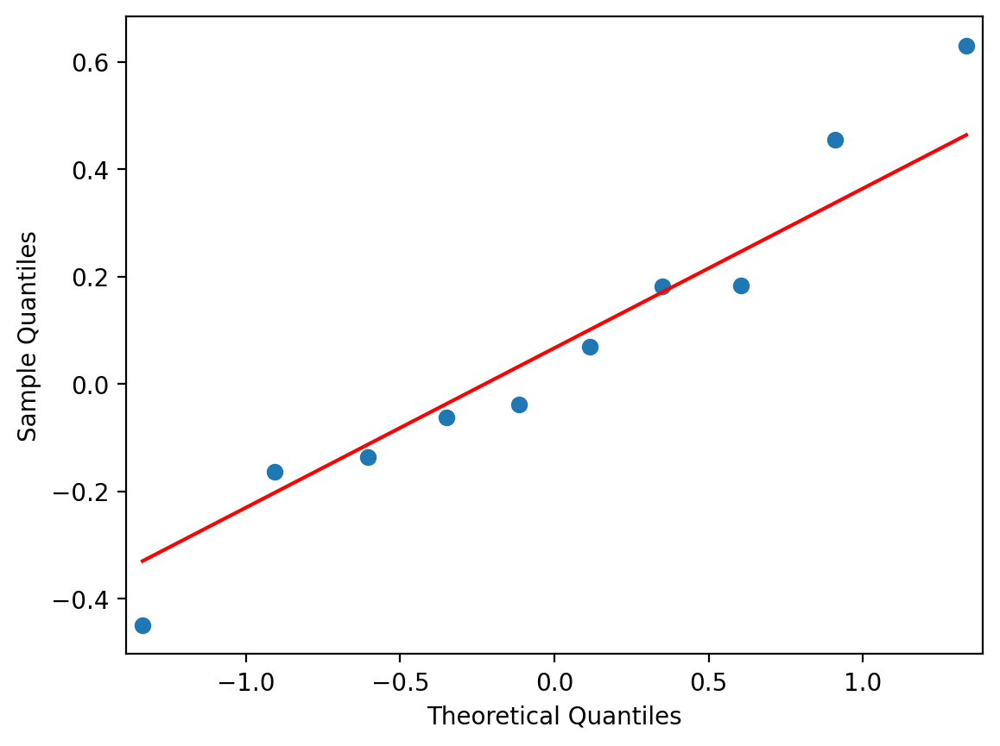

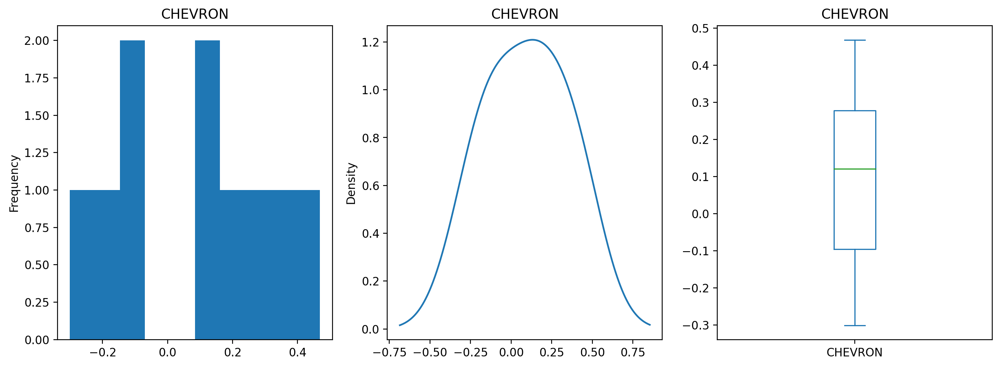

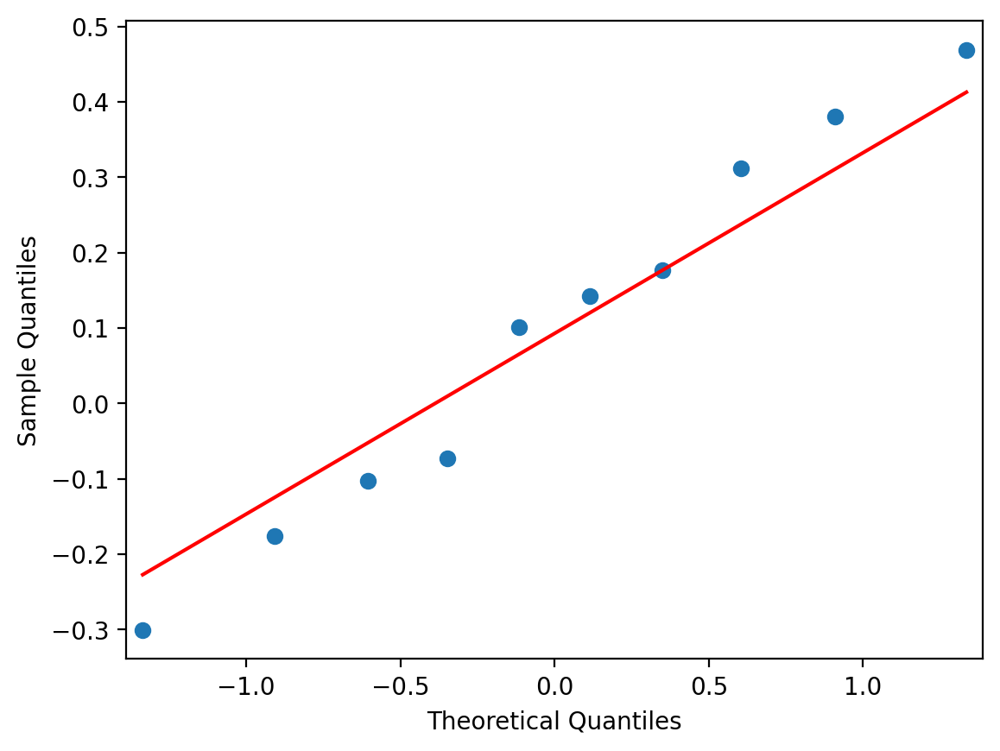

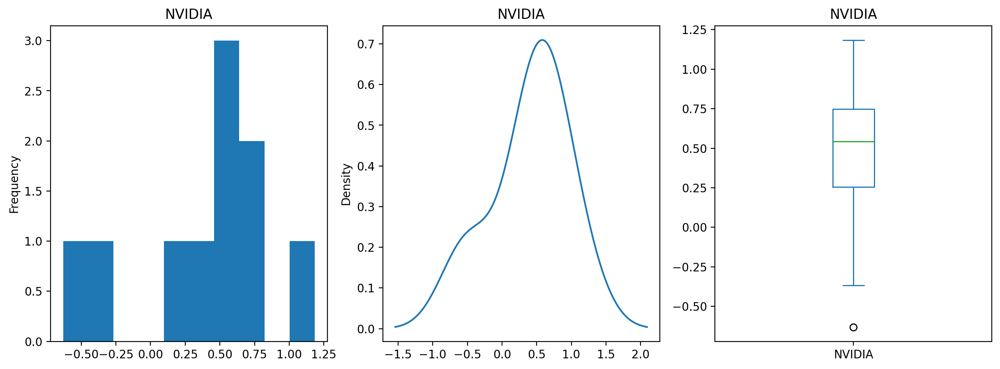

...

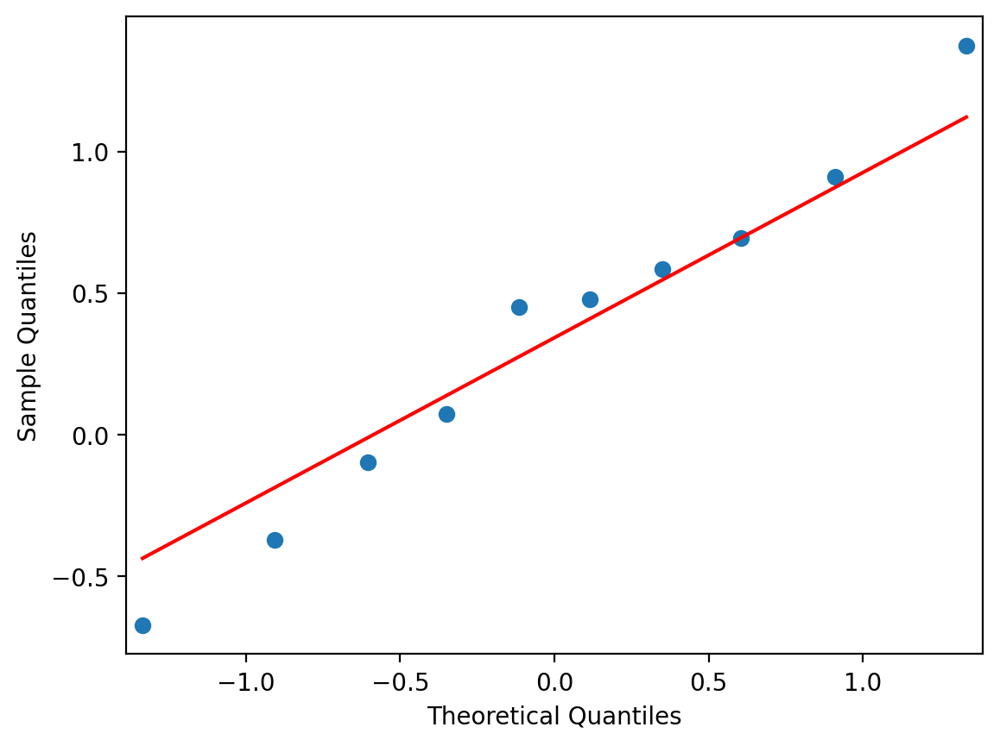

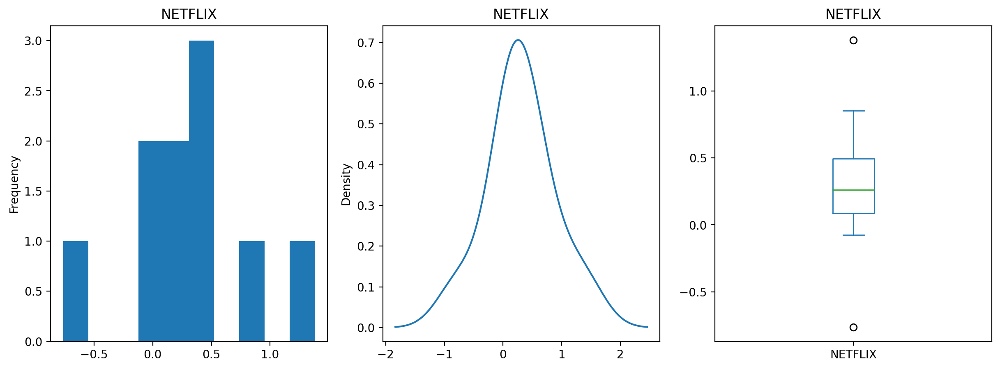

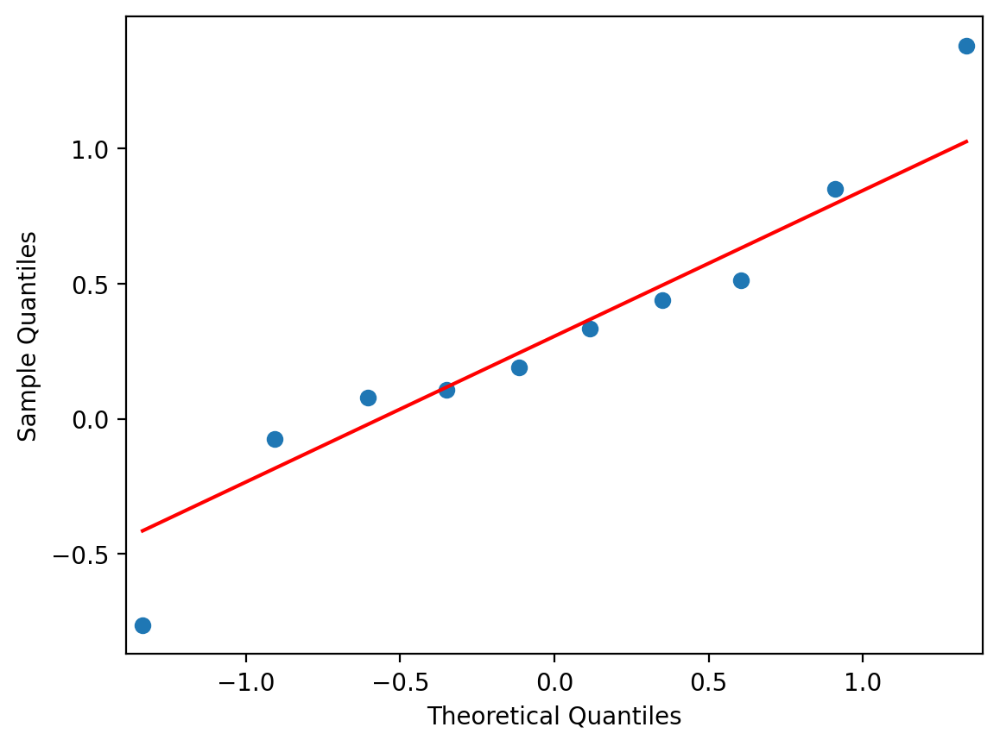

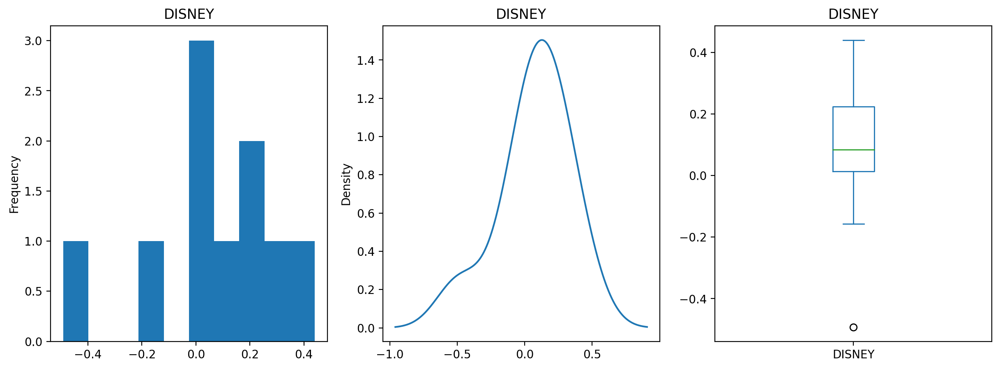

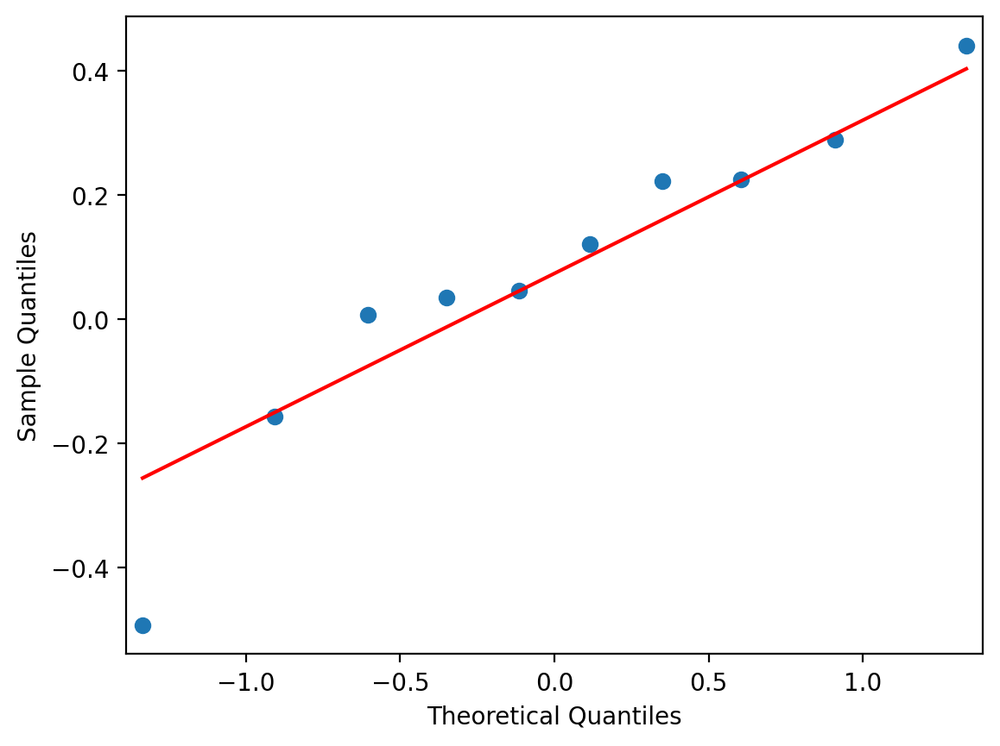

In [10]:
for stock in stocksString:
    createDiagnosticGraph(logReturn[stock], stocksString)

## Univariate descriptive statistics

### Mean

In [11]:
print(round(logReturn.mean(), 4))

EXXONMOBIL    0.0668
CHEVRON       0.0929
NVIDIA        0.4011
AMD           0.3420
NETFLIX       0.3056
DISNEY        0.0738
dtype: float64


### Variance

In [12]:
print(round(logReturn.var(), 4))

EXXONMOBIL    0.0982
CHEVRON       0.0638
NVIDIA        0.3019
AMD           0.3785
NETFLIX       0.3228
DISNEY        0.0676
dtype: float64


### Standard derivation

In [13]:
print(round(logReturn.std(), 4))

EXXONMOBIL    0.3134
CHEVRON       0.2526
NVIDIA        0.5495
AMD           0.6152
NETFLIX       0.5681
DISNEY        0.2599
dtype: float64


### Asimetria (Skew)

In [14]:
print(round(logReturn.skew(), 4))

EXXONMOBIL    0.3549
CHEVRON      -0.0365
NVIDIA       -0.7808
AMD          -0.1019
NETFLIX       0.0912
DISNEY       -1.0107
dtype: float64


### Kurtosi

In [15]:
print(round(logReturn.kurtosis(), 4))

EXXONMOBIL    0.1842
CHEVRON      -1.0925
NVIDIA        0.2557
AMD          -0.3446
NETFLIX       1.4292
DISNEY        1.7158
dtype: float64


## Covariance

In [16]:
logReturn.cov()

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
EXXONMOBIL,0.098203,0.075764,-0.043979,-0.048671,-0.085486,-0.052006
CHEVRON,0.075764,0.063808,-0.011922,-0.009257,-0.066010,-0.038015
NVIDIA,-0.043979,-0.011922,0.301928,0.214519,0.101552,0.055344
AMD,-0.048671,-0.009257,0.214519,0.378486,0.117188,0.065517
NETFLIX,-0.085486,-0.066010,0.101552,0.117188,0.322775,0.114558
DISNEY,-0.052006,-0.038015,0.055344,0.065517,0.114558,0.067564


## Correlation Matrix


In [17]:
logReturn.corr()

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
EXXONMOBIL,1.000000,0.957113,-0.255409,-0.252454,-0.480157,-0.638467
CHEVRON,0.957113,1.000000,-0.085892,-0.059568,-0.459961,-0.578979
NVIDIA,-0.255409,-0.085892,1.000000,0.634583,0.325303,0.387489
AMD,-0.252454,-0.059568,0.634583,1.000000,0.335281,0.409707
NETFLIX,-0.480157,-0.459961,0.325303,0.335281,1.000000,0.775741
DISNEY,-0.638467,-0.578979,0.387489,0.409707,0.775741,1.000000


## Correlations

### Time correlation

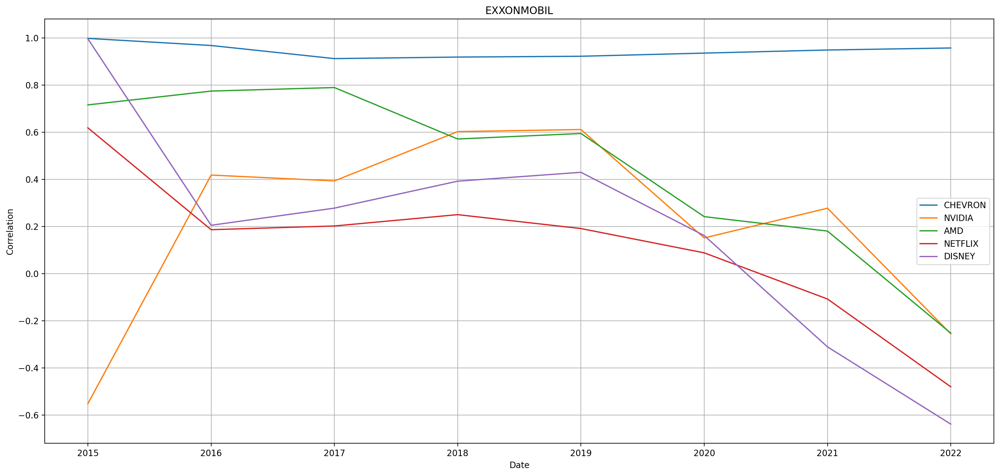

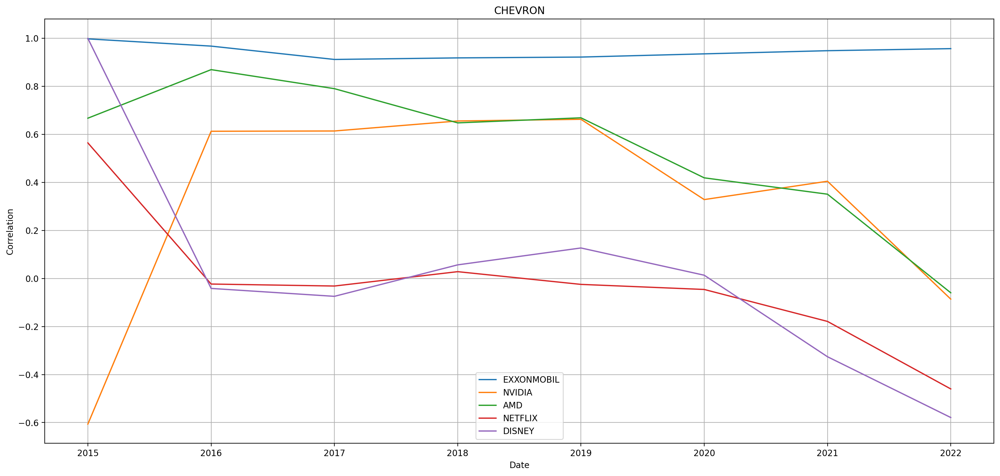

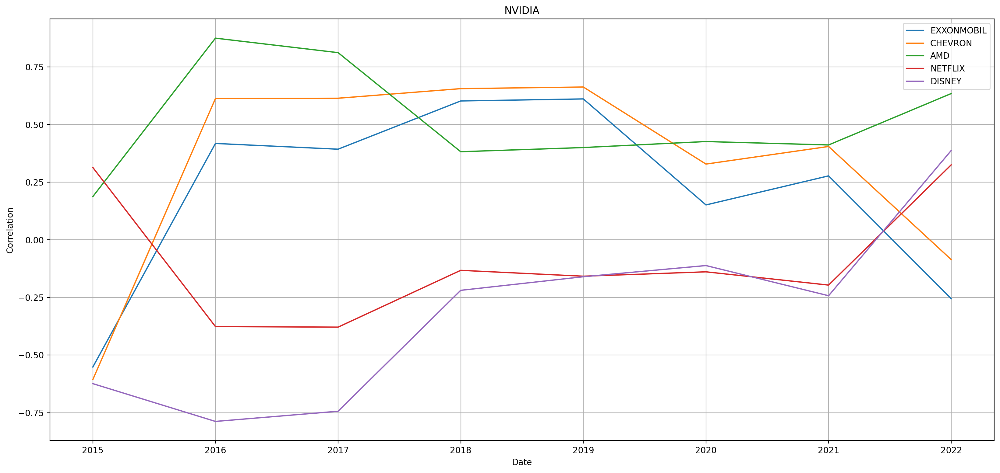

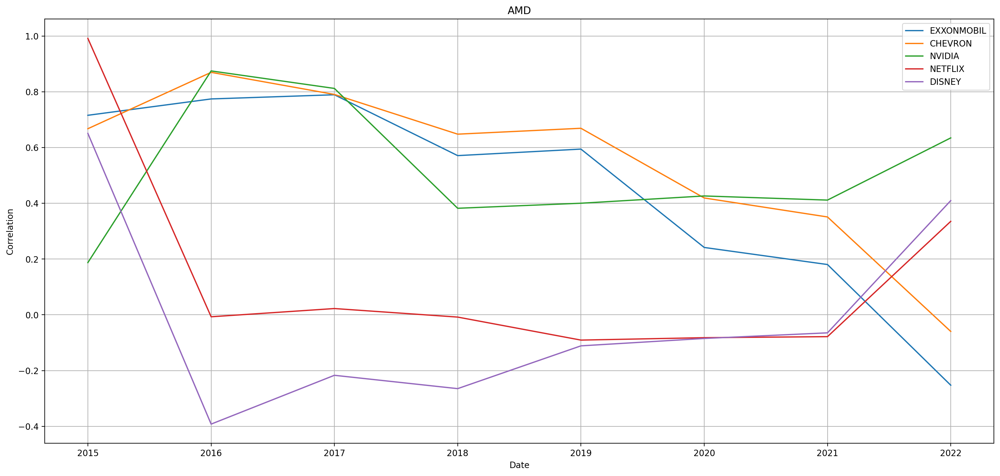

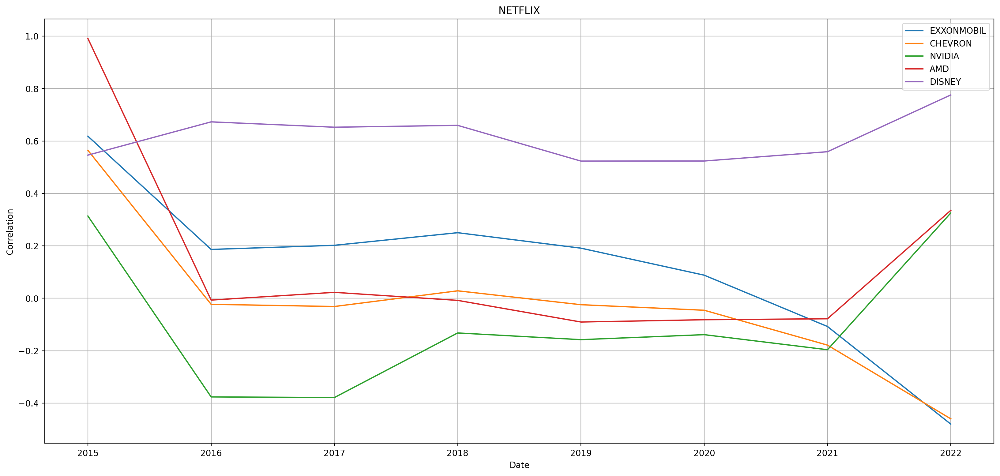

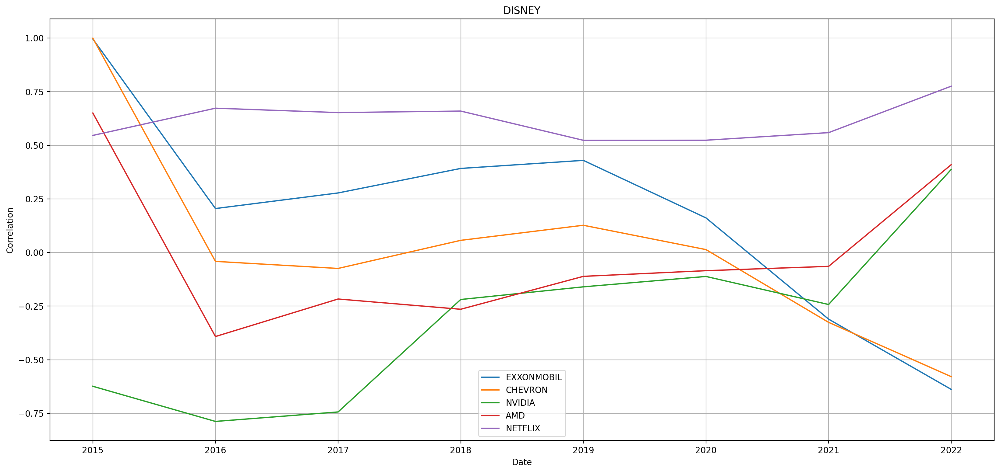

In [18]:
correlationAssets = dict()
correlationAssets = createCorrelationTime(logReturn, stocksString)
createPlotCorrelationTime(correlationAssets, stocksString)

### Scatter plots correlation

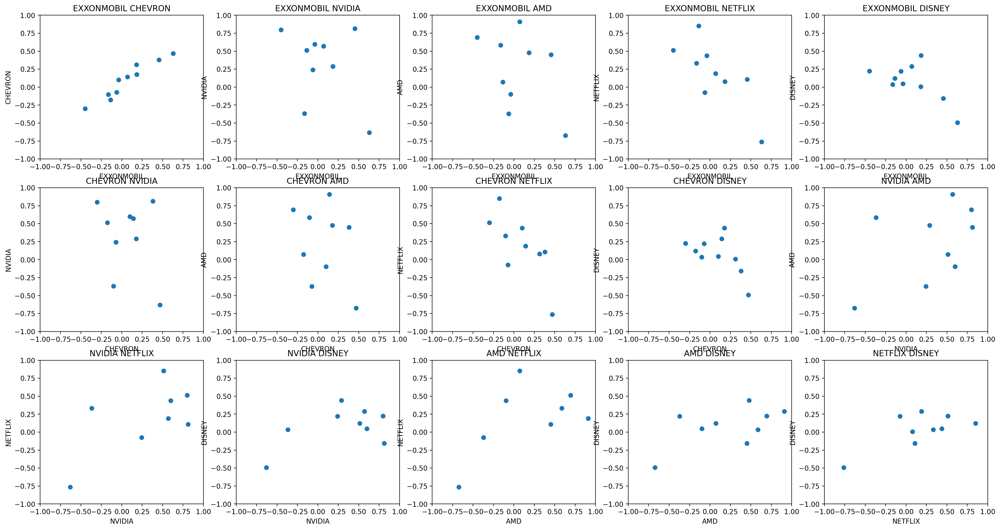

In [19]:
createScatterPlot(logReturn, "Scatter Plot", stocksString)

## ARIMA model

### Division set

In [20]:
training = closeMonthly[0:-11]
training

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2012-11-30,57.710148,69.891815,2.764091,2.200000,11.672857,44.462769
2012-12-31,56.669086,71.511948,2.831059,2.400000,13.227143,45.263733
2013-01-31,58.908360,76.147614,2.831059,2.600000,23.605715,48.981918
2013-02-28,59.007961,78.073334,2.941360,2.490000,26.868570,49.627380
2013-03-31,59.376942,79.186287,2.980857,2.550000,27.040001,51.636471
...,...,...,...,...,...,...
2021-08-31,51.744308,92.338142,223.613510,110.720001,569.190002,181.300003
2021-09-30,55.825386,96.803818,206.941116,102.900002,610.340027,169.169998
2021-10-31,61.187740,109.246613,255.399887,120.230003,690.309998,169.070007


### SARIMAX

In [21]:
aic, order, seasonal = dict(), dict(), dict()                   #uso i dict perchè poi mi consentono di accedere ai valori associati al singolo asset
for stock in stocksString:
    aic[stock], order[stock], seasonal[stock] = arima(training[stock], 12)
    print('ARIMA {}x{}'.format(order[stock], seasonal[stock]))
    print('Lowest AIC: %.3f'%aic[stock])

ARIMA (1, 1, 1)x(1, 1, 1, 12)
Lowest AIC: 467.493
ARIMA (0, 1, 1)x(1, 1, 1, 12)
Lowest AIC: 543.613
ARIMA (0, 1, 1)x(1, 1, 1, 12)
Lowest AIC: 661.131
ARIMA (0, 1, 1)x(1, 1, 1, 12)
Lowest AIC: 548.184
ARIMA (0, 1, 1)x(0, 1, 1, 12)
Lowest AIC: 799.750
ARIMA (0, 1, 1)x(0, 1, 1, 12)
Lowest AIC: 622.675


                                     SARIMAX Results                                      
Dep. Variable:                         EXXONMOBIL   No. Observations:                  110
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                -228.746
Date:                            Sun, 15 Jan 2023   AIC                            467.493
Time:                                    14:13:32   BIC                            479.587
Sample:                                11-30-2012   HQIC                           472.351
                                     - 12-31-2021                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9261      0.090    -10.290      0.000      -1.102      -0.750
ma.L1          0.8155      0.163   

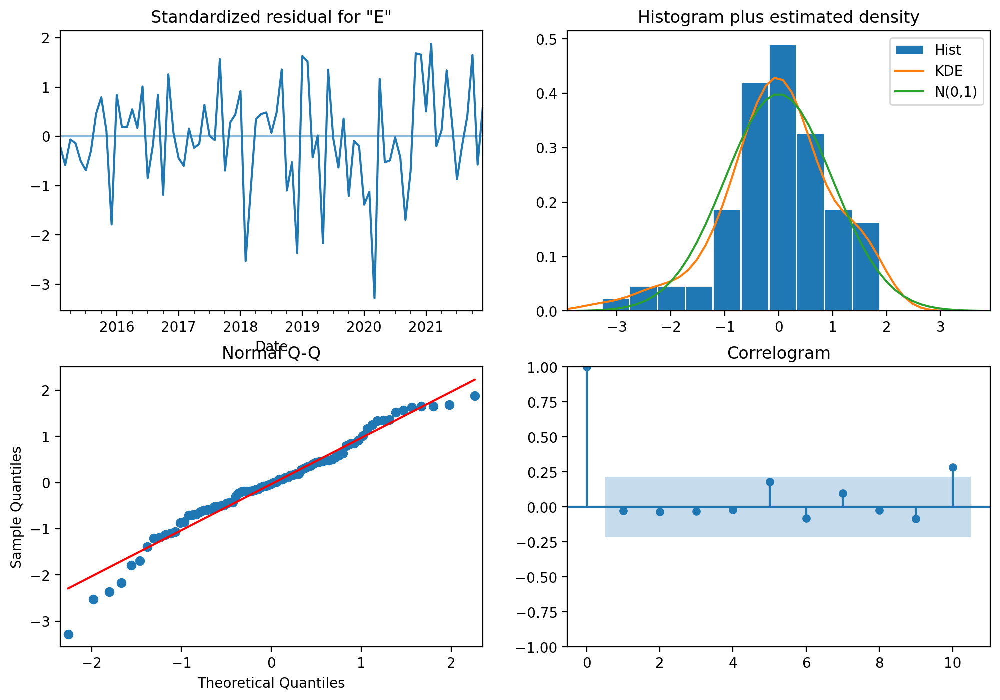

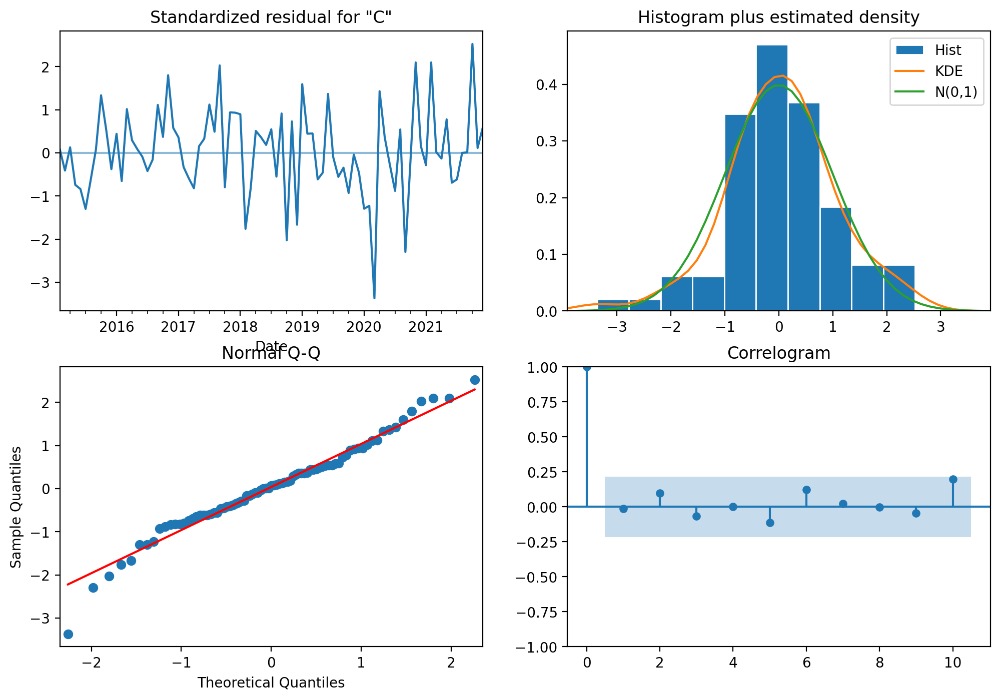

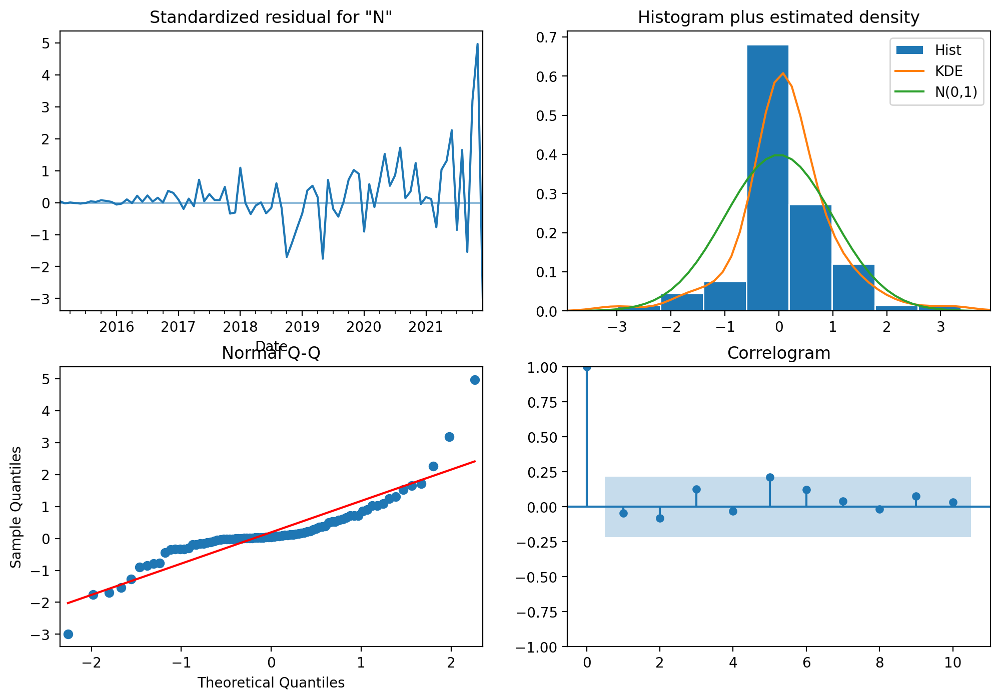

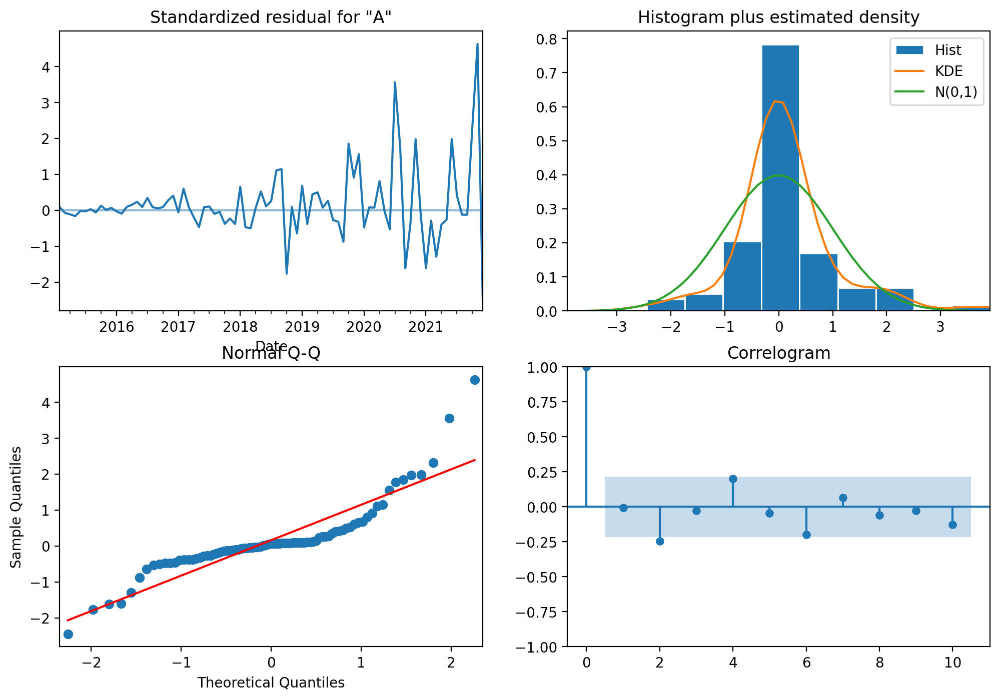

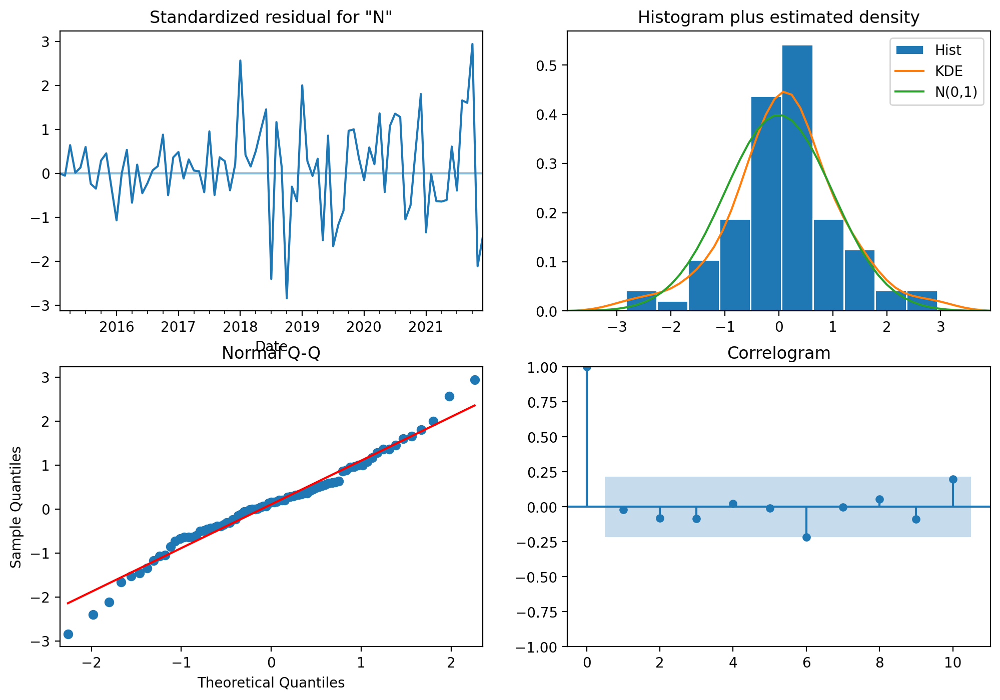

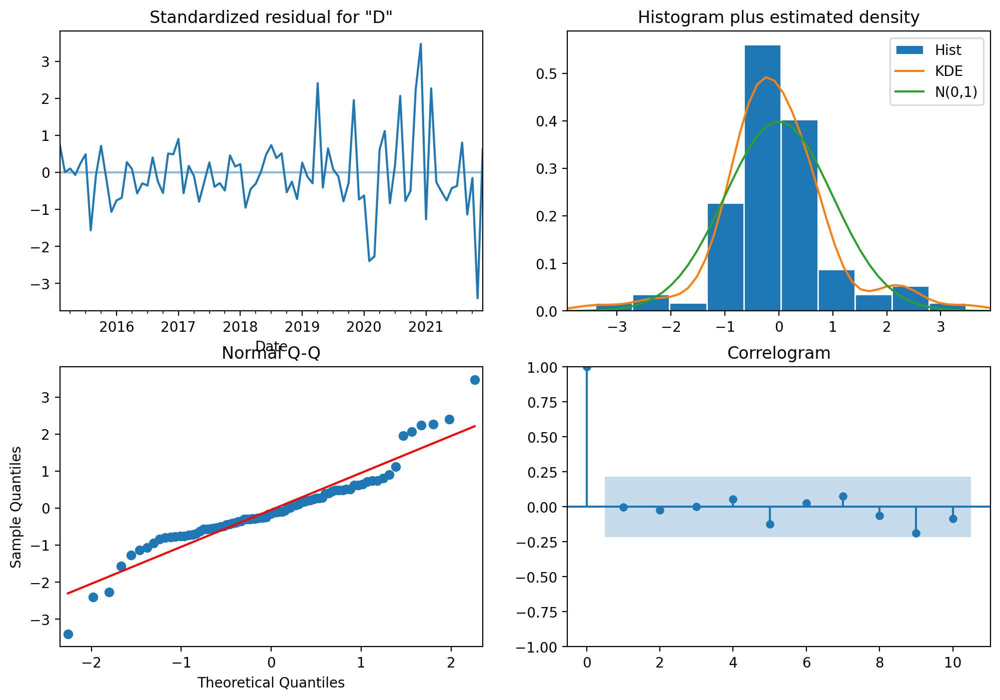

In [22]:
model = dict()
for stock in stocksString:
    model[stock] = SARIMAX(training[stock], order = order[stock], seasonal_order = seasonal[stock], enforce_stationarity=False, enforce_invertibility=False, disp = False)
    model[stock] = model[stock].fit(maxiter=200, disp=False)
    print(model[stock].summary())
    model[stock].plot_diagnostics(figsize=(12,8))

### Prediction

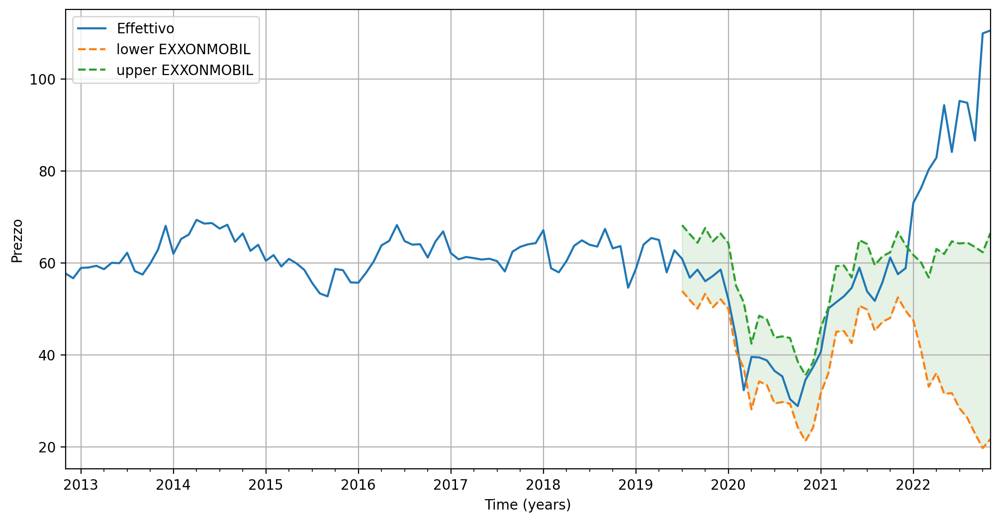

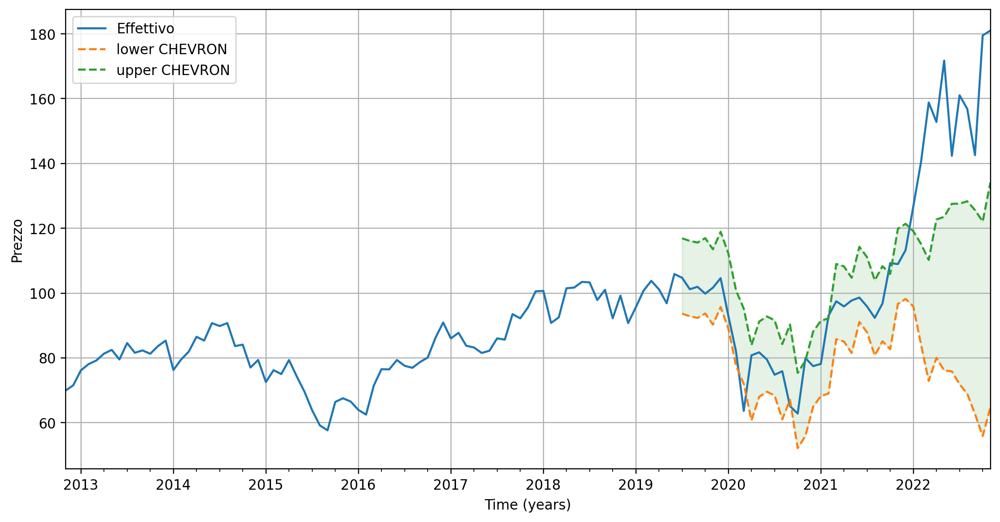

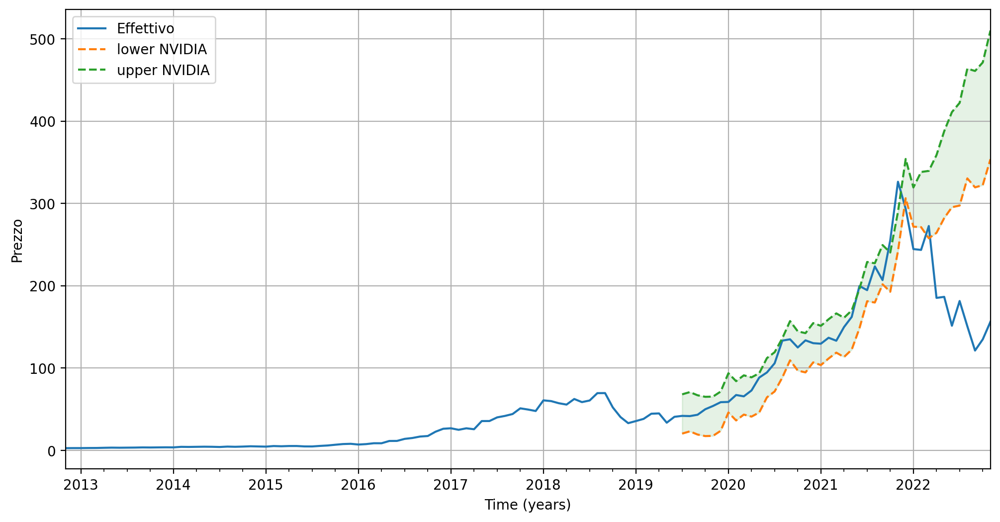

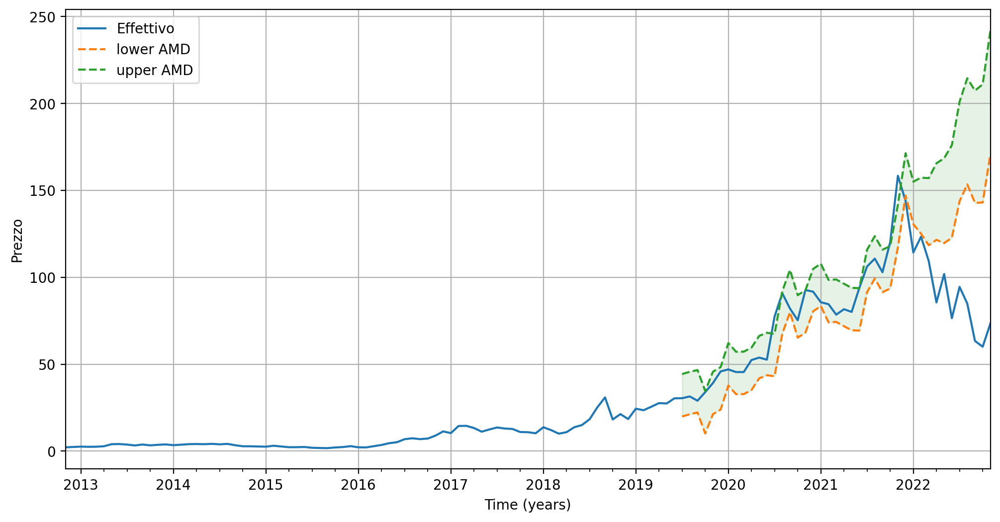

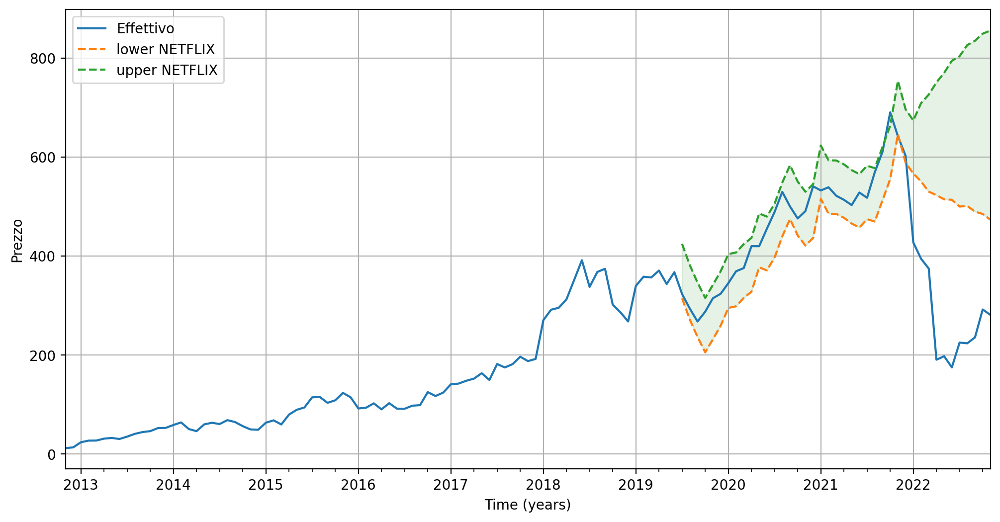

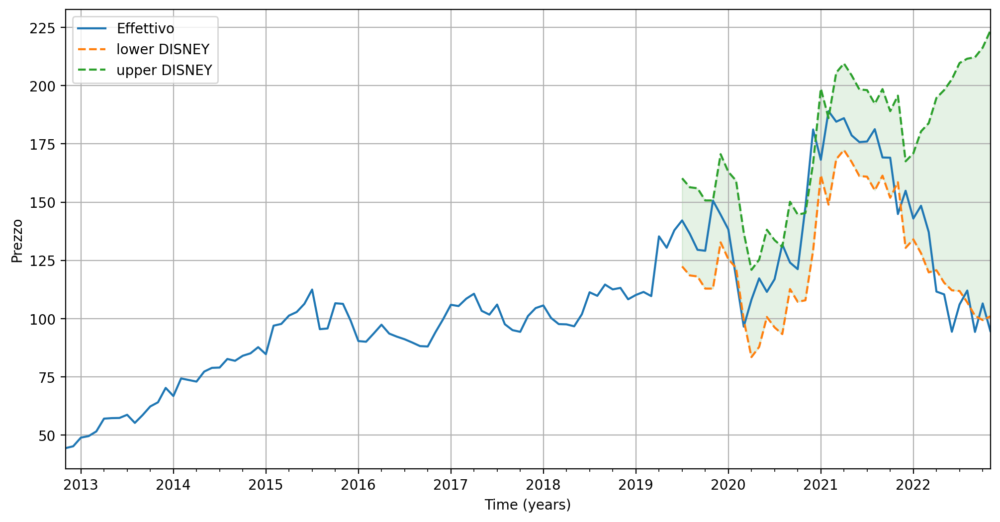

In [23]:
predCi = dict()
lenTraining = len(training.index)
for stock in stocksString:
    prediction = model[stock].get_prediction(start=lenTraining-30, end = lenTraining+10)
    predictionCi = prediction.conf_int()
    predCi[stock] = predictionCi
    createArimaxGraphs(closeMonthly, stock, lenTraining, model, predictionCi)

## Trading and backtesting strategy

### Strategy MACD

In [24]:
macd = stocks
macd = strategyMACD(macd, stocksString)
macd

,Adj Close_EXXONMOBIL,Volume_EXXONMOBIL,Adj Close_CHEVRON,Volume_CHEVRON,Adj Close_NVIDIA,Volume_NVIDIA,Adj Close_AMD,Volume_AMD,Adj Close_NETFLIX,Volume_NETFLIX,...,Position_NVIDIA,Position_AMD,Position_NETFLIX,Position_DISNEY,Advice_EXXONMOBIL,Advice_CHEVRON,Advice_NVIDIA,Advice_AMD,Advice_NETFLIX,Advice_DISNEY
Date,,,,,,,,,,,,,,,,,,,,,
2012-11-30,57.710148,15522100,69.891815,6676400,2.764091,46050400.0,2.200000,66853900,11.672857,14986300,...,down,down,down,down,-,-,-,-,-,-
2012-12-03,57.363144,10937300,69.210678,5736400,2.713290,39138000.0,2.360000,70160800,10.857143,29197700,...,down,down,down,down,-,-,-,-,-,-
2012-12-04,57.088131,11980000,68.747757,6665100,2.794112,52806800.0,2.260000,52165300,12.378571,101757600,...,down,down,down,down,-,-,-,-,-,-
2012-12-05,57.441704,12717800,69.547935,6430800,2.761783,63302400.0,2.290000,20378800,11.910000,59357900,...,down,down,down,down,-,-,-,-,-,-
2012-12-06,57.618488,12077000,70.394379,7392300,2.766402,41289600.0,2.340000,22223500,12.310000,38103800,...,down,down,down,down,-,-,-,-,-,-
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-22,114.180000,17719100,185.889999,9018000,160.338989,47286600.0,75.250000,55450200,286.690002,6245100,...,down,down,up,down,-,-,-,-,-,-
2022-11-23,113.610001,11546700,184.240005,5831200,165.147751,42724100.0,76.400002,81623600,291.500000,5919000,...,down,down,up,down,-,-,-,-,-,-
2022-11-25,113.209999,7136000,183.699997,2796400,162.658386,16793400.0,75.139999,26018900,285.540009,3236000,...,down,down,up,down,-,-,-,-,-,-


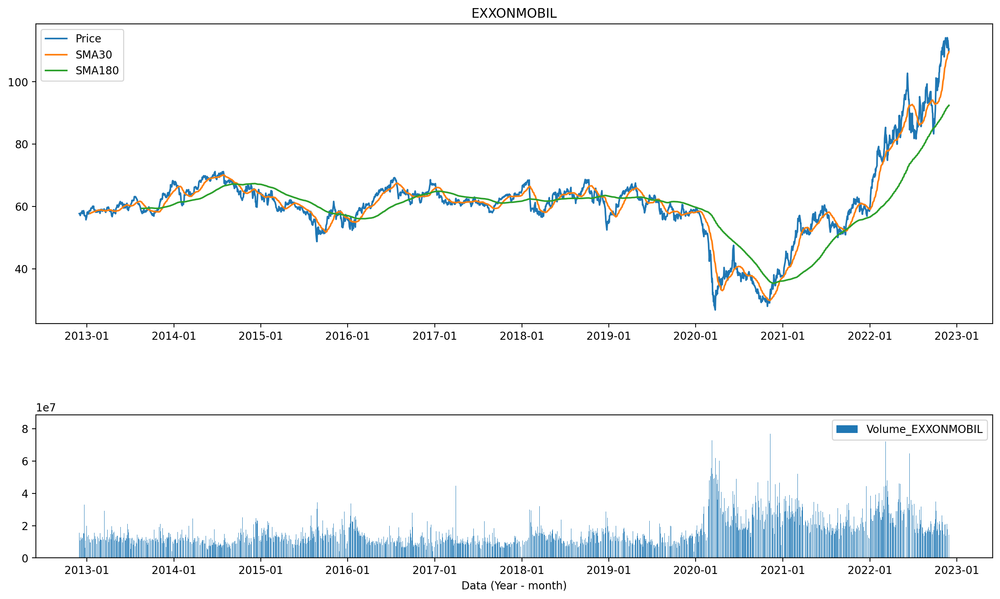

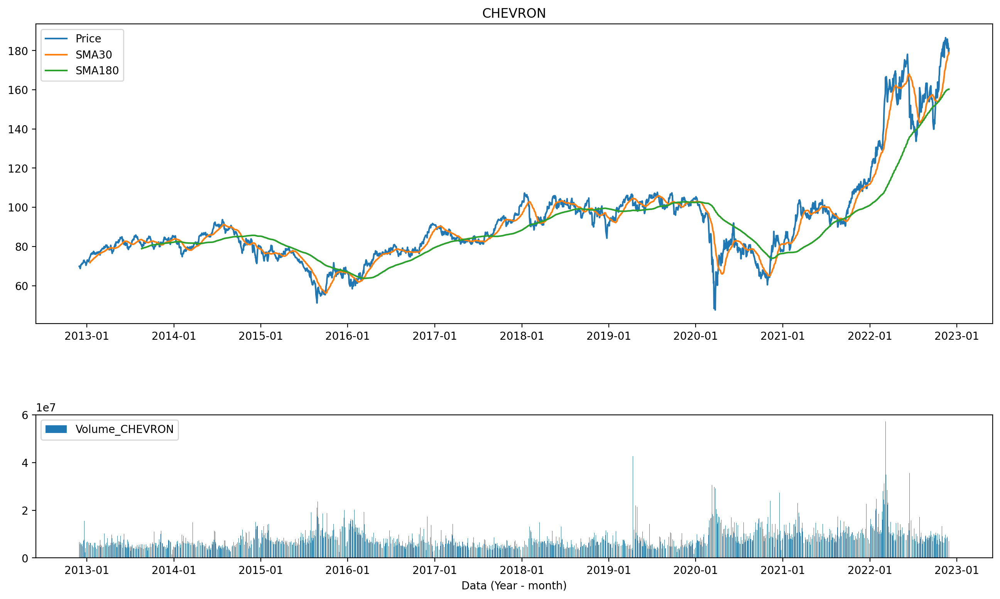

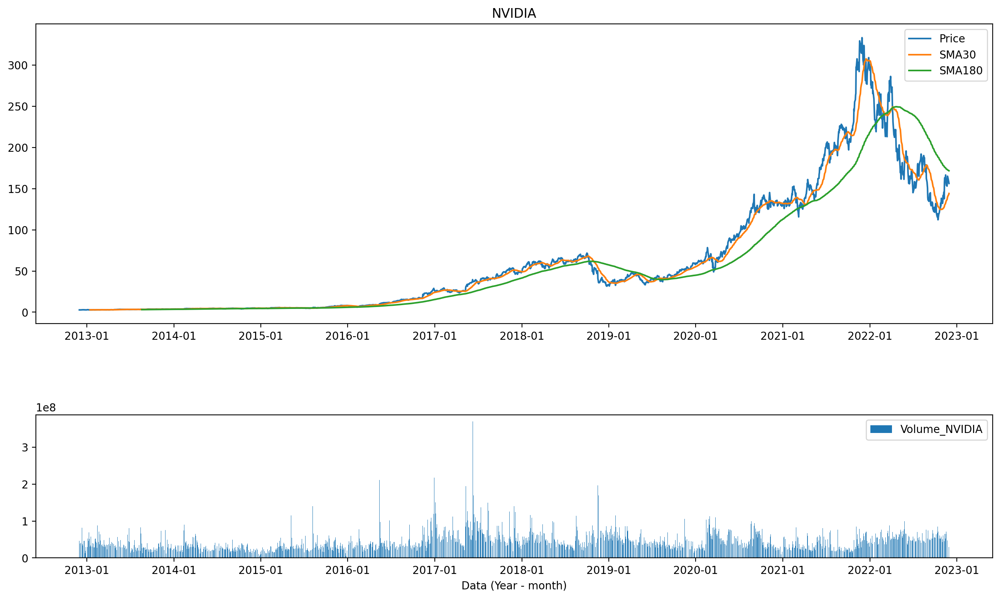

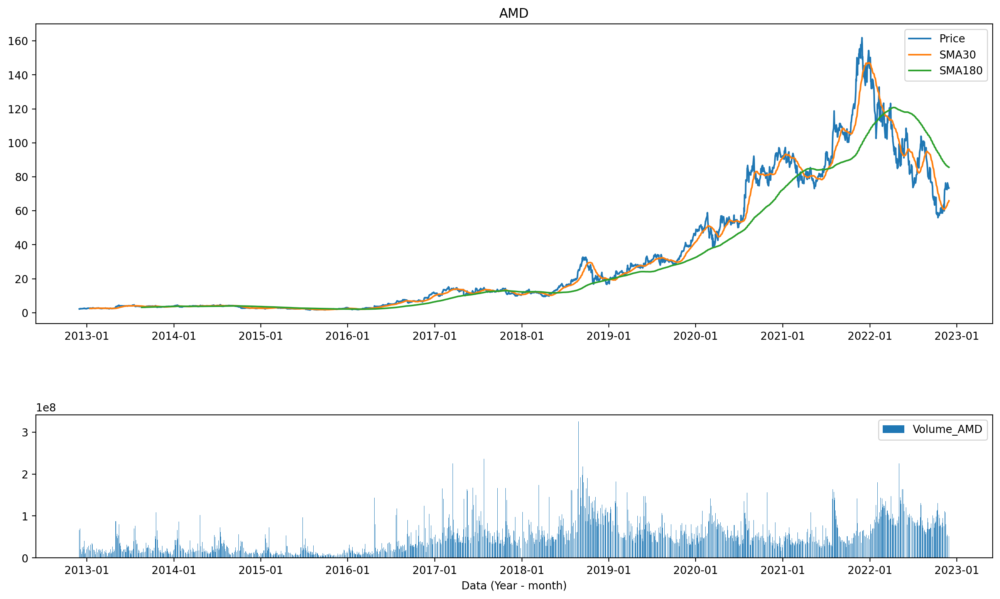

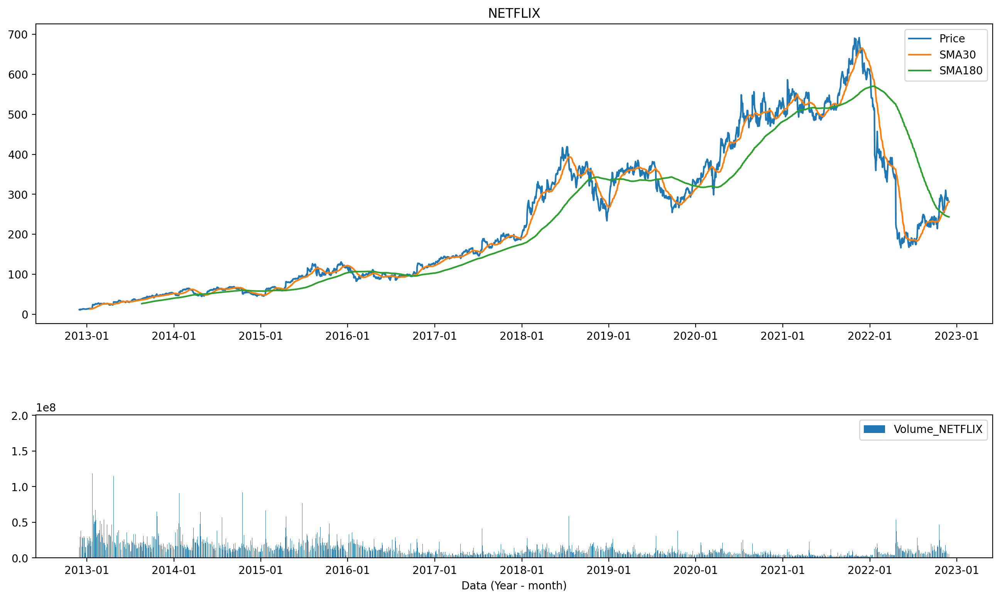

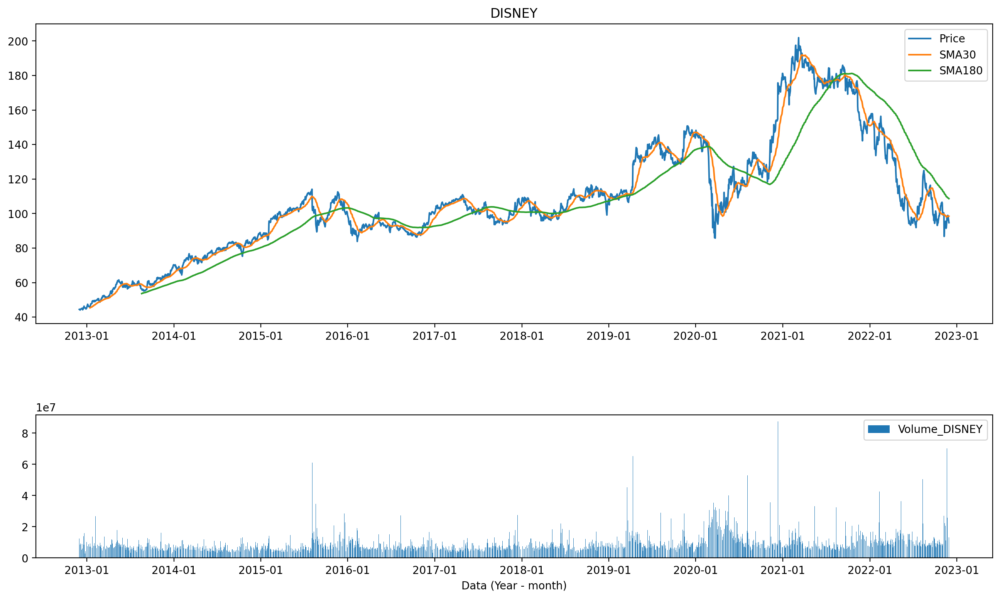

In [25]:
for stock in stocksString:
    createGraphStrategy(macd, stock)

In [26]:
macd, sma = strategyPerformance(macd, stocksString)

### Strategy efficiency

In [27]:
sma

,Adj Close_EXXONMOBIL,Volume_EXXONMOBIL,Adj Close_CHEVRON,Volume_CHEVRON,Adj Close_NVIDIA,Volume_NVIDIA,Adj Close_AMD,Volume_AMD,Adj Close_NETFLIX,Volume_NETFLIX,...,Return_NVIDIA,Return_AMD,Return_NETFLIX,Return_DISNEY,rtnEXXONMOBIL,rtnCHEVRON,rtnNVIDIA,rtnAMD,rtnNETFLIX,rtnDISNEY
Date,,,,,,,,,,,,,,,,,,,,,
2013-08-19,58.069771,11745600,80.375938,4308900,3.491052,39343200.0,3.600000,14414700,37.111427,15497300,...,0.984200,0.983607,1.003515,0.994531,NaN,NaN,NaN,NaN,NaN,NaN
2013-08-20,58.009621,16498800,80.125320,4490700,3.508654,23419200.0,3.630000,16665100,39.041428,30140600,...,0.989162,0.991803,1.055704,0.995335,-0.001036,-0.003118,0.005042,0.008333,0.052006,0.000809
2013-08-21,57.735699,12766900,79.725662,5648600,3.492225,26154000.0,3.610000,13992800,38.624287,21258300,...,0.984531,0.986339,1.044424,0.983432,-0.004722,-0.004988,-0.004683,-0.005510,-0.010685,-0.011959
2013-08-22,58.109840,10199900,80.125320,4028600,3.511000,12901600.0,3.630000,10071400,38.535713,9961700,...,0.989824,0.991803,1.042029,0.991475,0.006480,0.005013,0.005376,0.005540,-0.002293,0.008178
2013-08-23,58.470604,9206400,80.965271,4675900,3.511000,24512000.0,3.650000,22498900,39.765713,22285200,...,0.989824,0.997268,1.075289,0.992923,0.006208,0.010483,0.000000,0.005510,0.031918,0.001460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-07-27,54.067440,16861400,94.725174,8332100,191.843262,24886300.0,91.029999,69427000,518.909973,2759000,...,4.267536,1.642585,4.473054,2.090275,-0.011115,-0.003368,-0.004457,-0.008604,0.004685,0.004252
2021-07-28,54.432068,16855300,95.261841,8546100,194.789597,20219100.0,97.930000,140561000,519.299988,2390500,...,4.333077,1.767092,4.476415,2.085617,0.006744,0.005666,0.015358,0.075799,0.000752,-0.002228
2021-07-29,55.095871,18607800,96.570541,8681300,196.377625,19078100.0,102.949997,164091800,514.250000,1736000,...,4.368402,1.857675,4.432884,2.076883,0.012195,0.013738,0.008153,0.051261,-0.009725,-0.004188


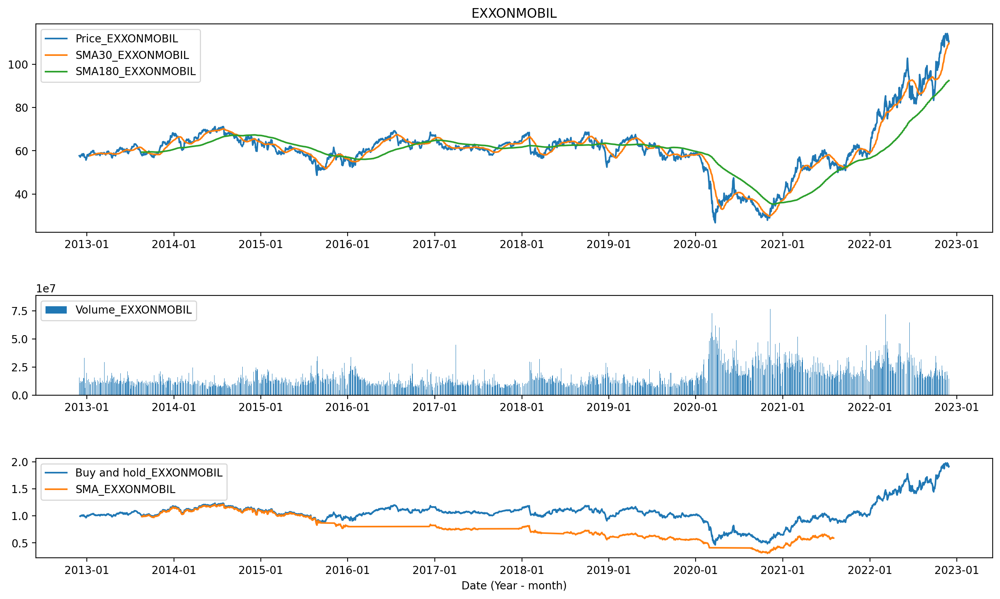

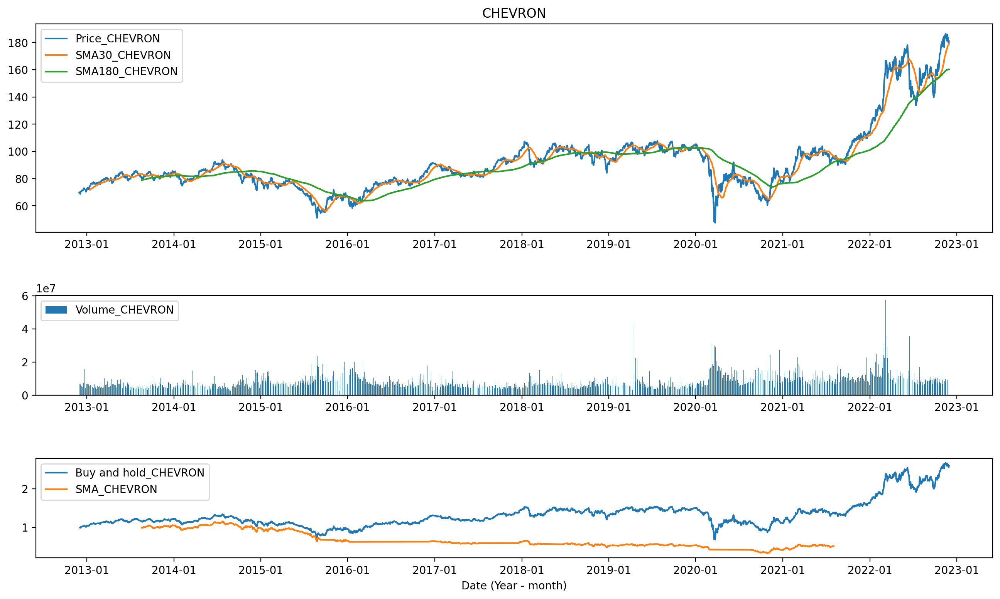

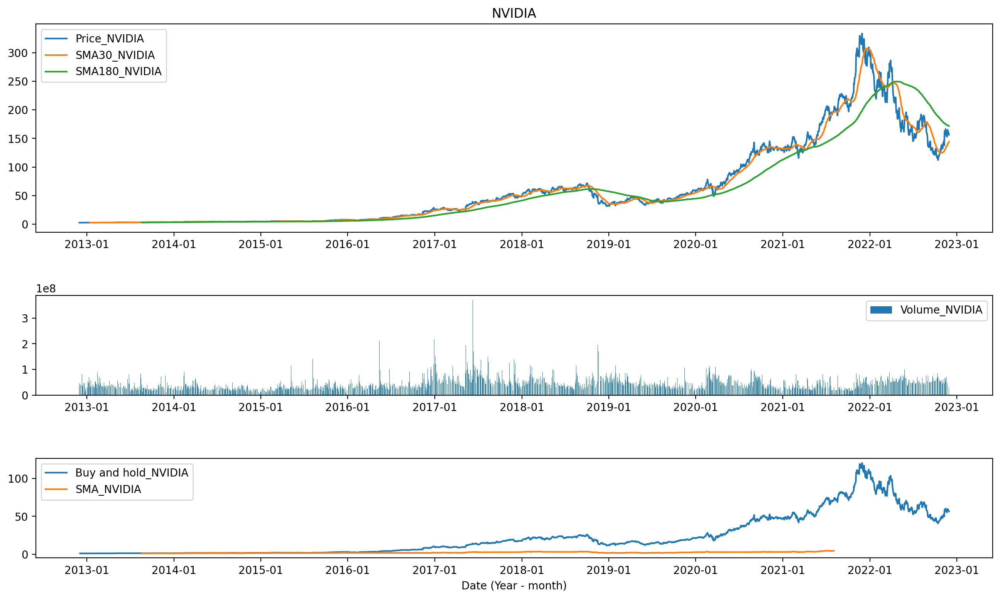

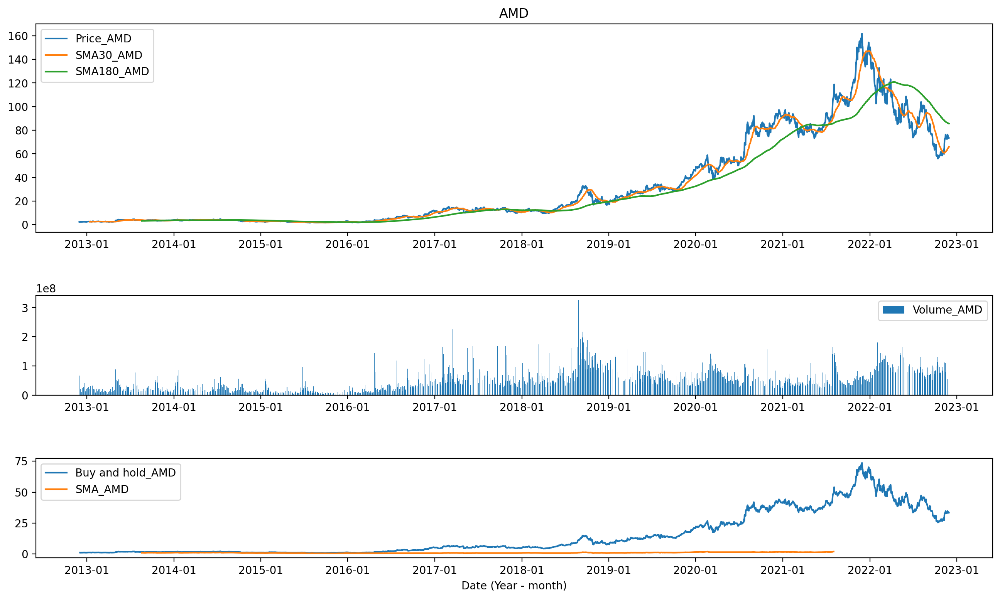

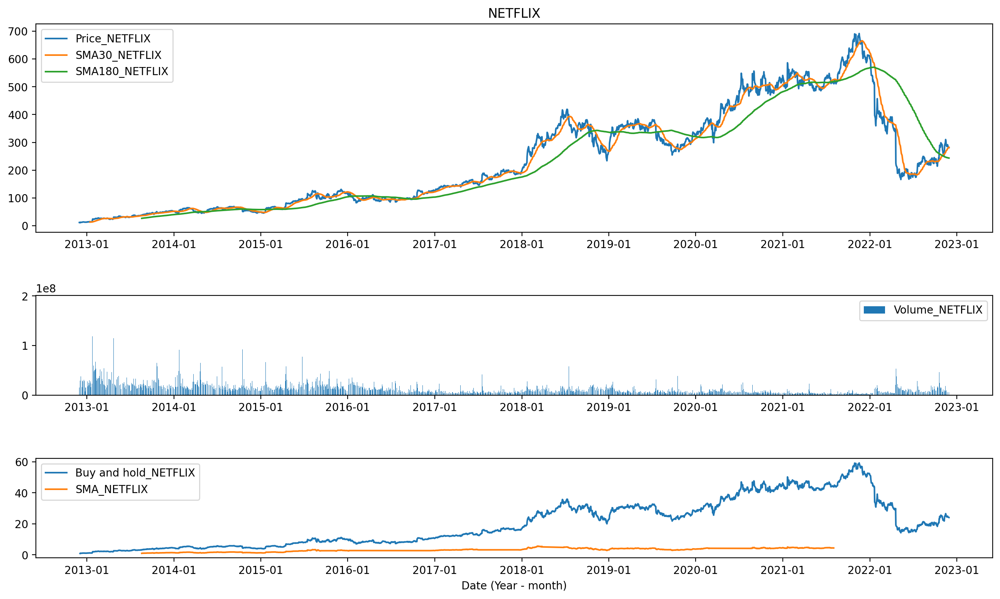

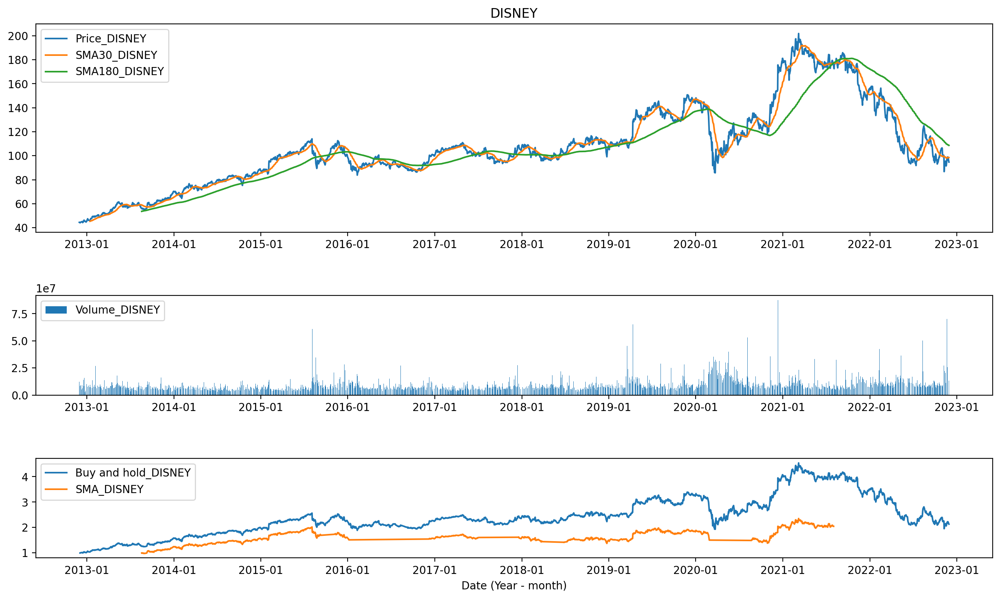

In [28]:
createGraphStrategyEfficiencyBuyHold(macd, sma, stocksString)

### VIX

In [29]:
vixString = createvixString(stocksString)
vixAsset = createAdjCloseVixAsset(vix, stocks, vixString)

array([<AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>], dtype=object)

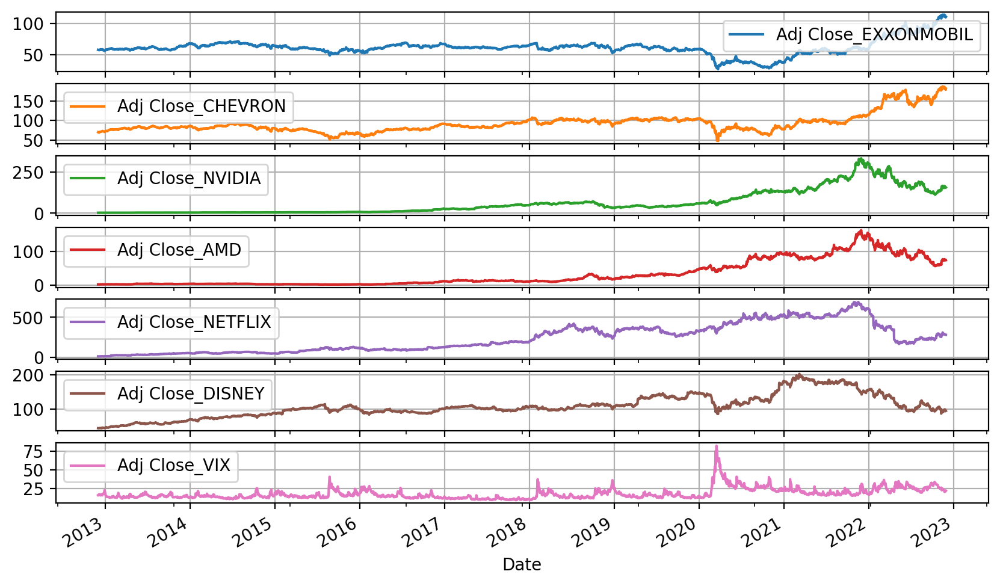

In [30]:
vixAsset.plot(subplots=True, figsize=(10,6), grid = True)

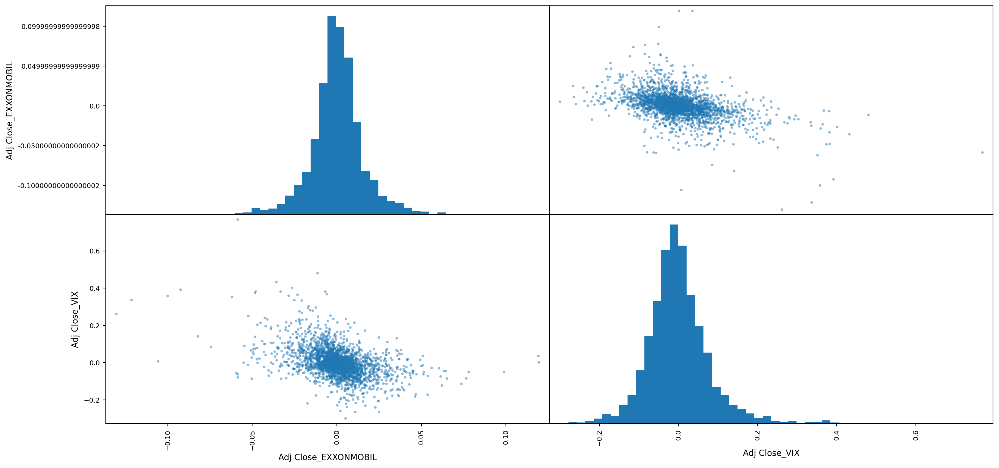

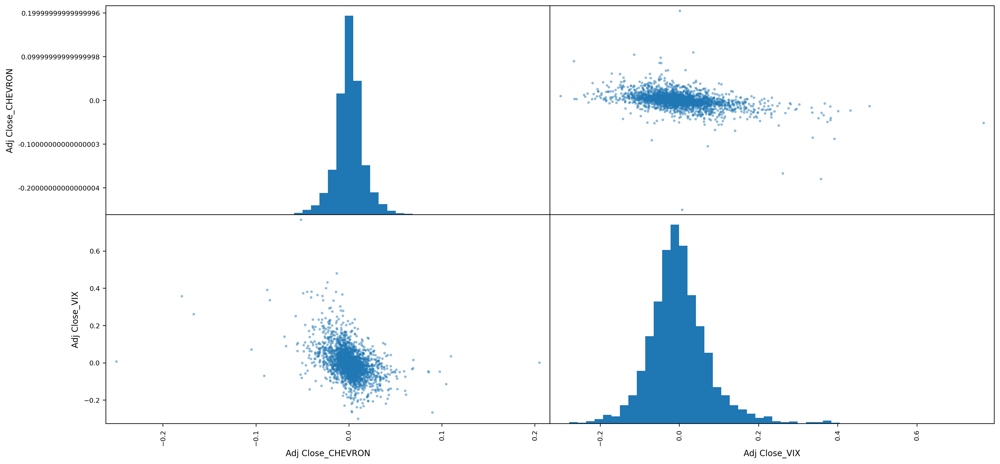

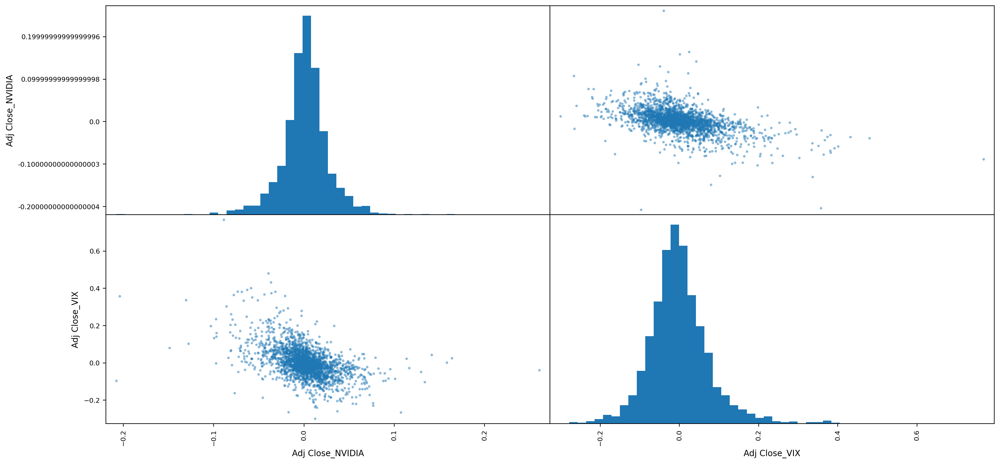

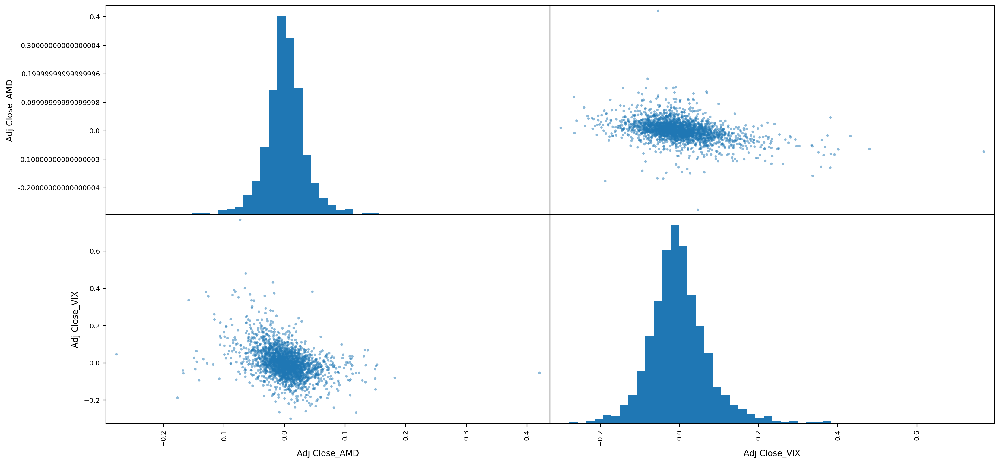

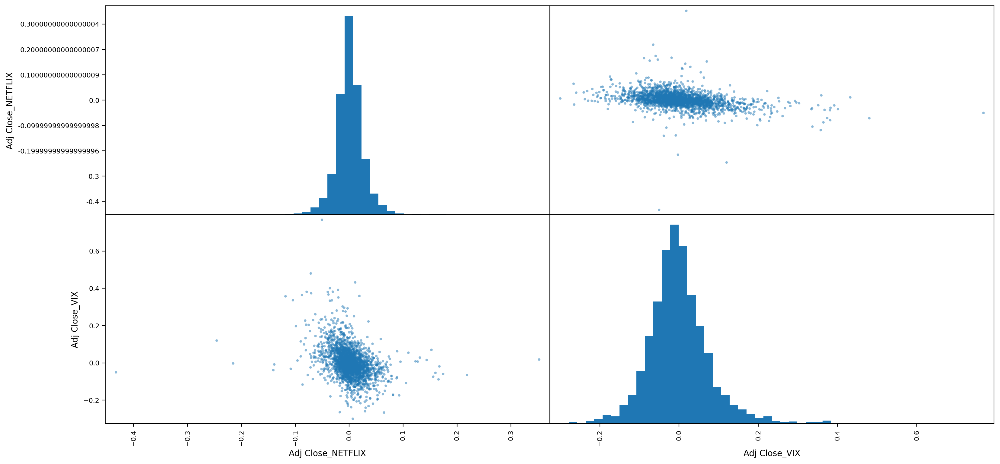

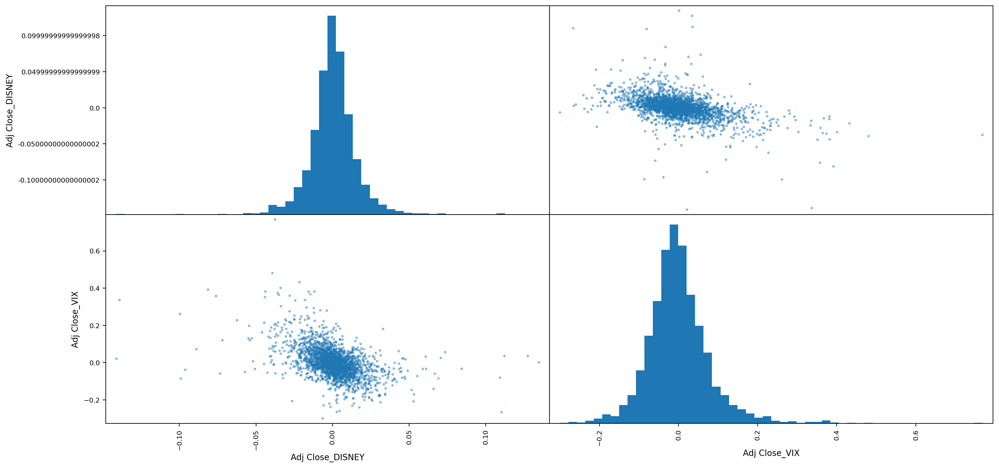

In [31]:
vixLog = np.log(vixAsset / vixAsset.shift(1))
createVixGraph(vixLog, stocksString)

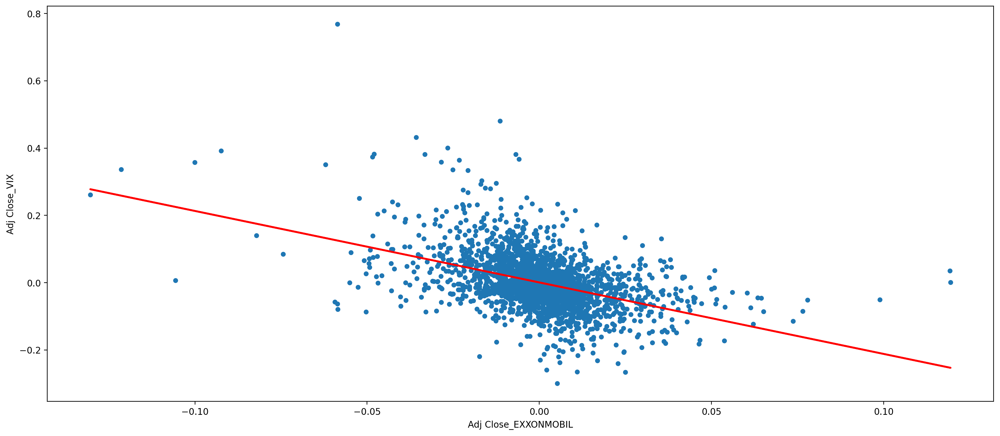

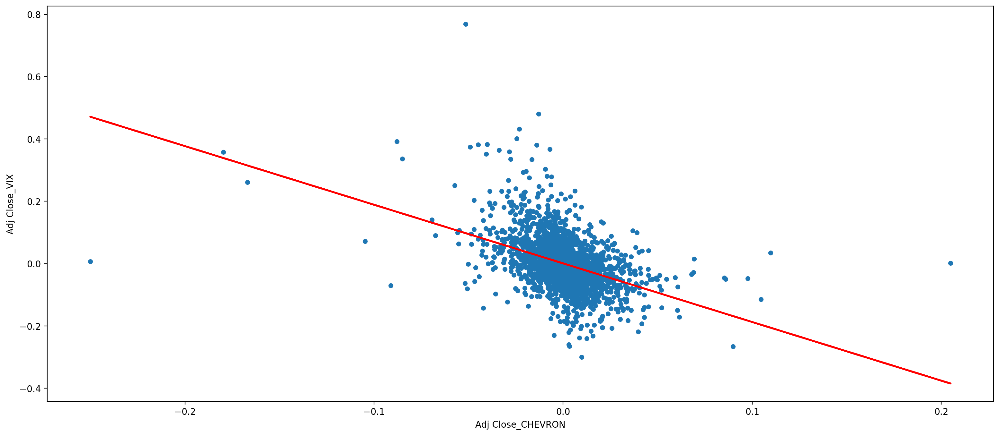

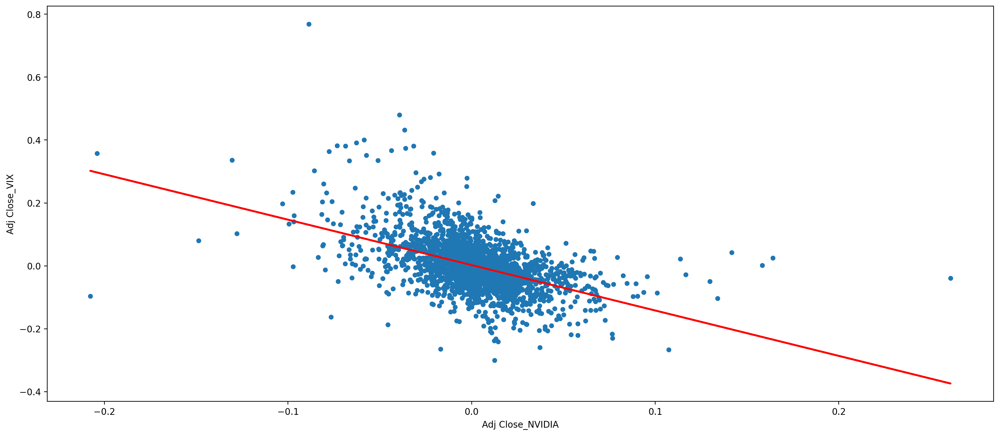

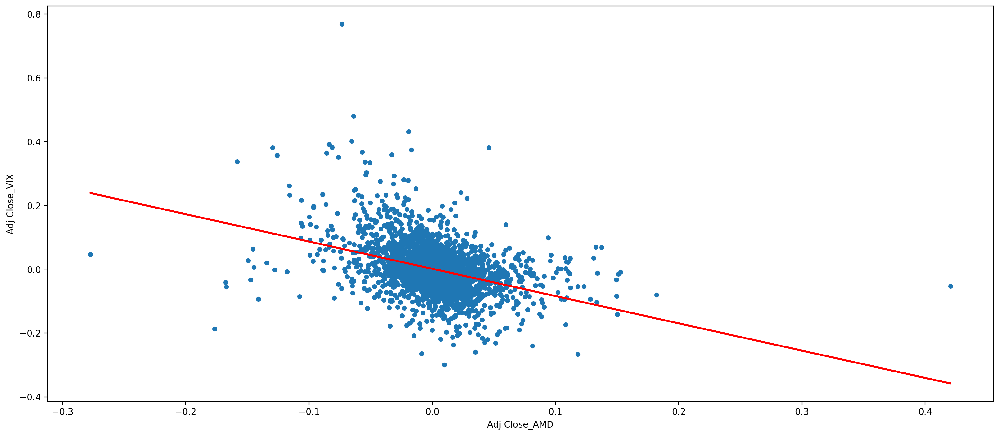

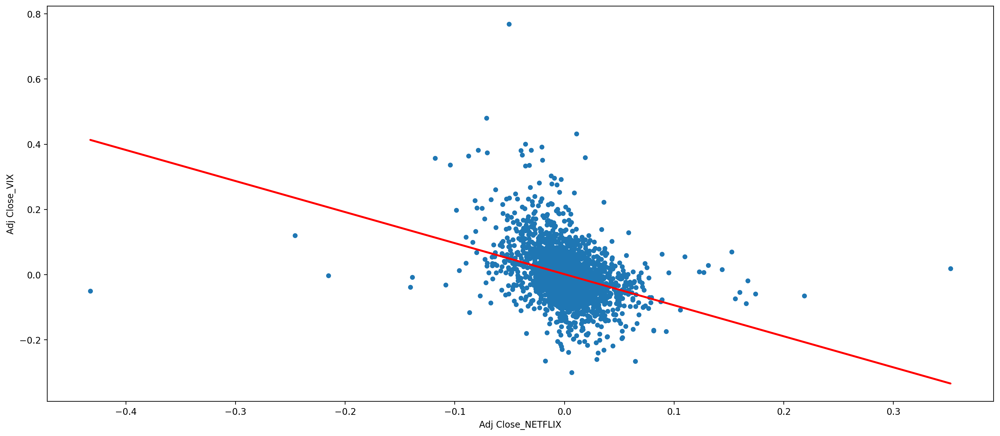

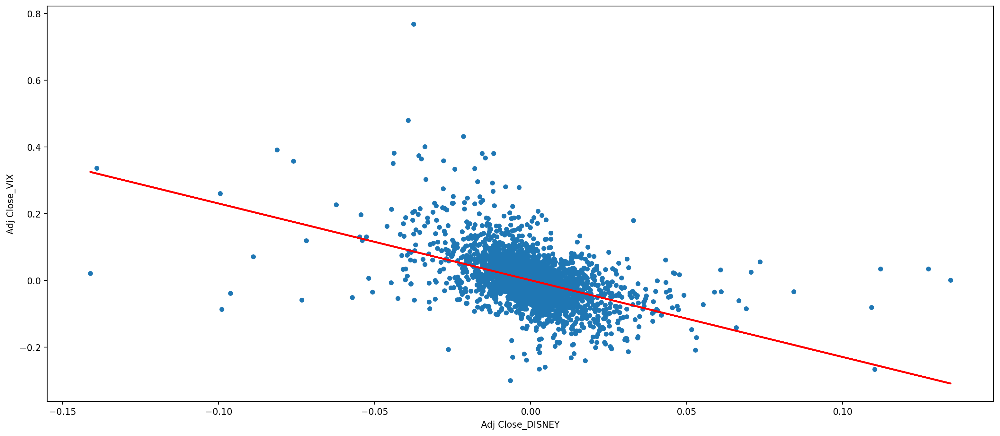

In [32]:
createScatterPlotVix(vixLog, stocksString)

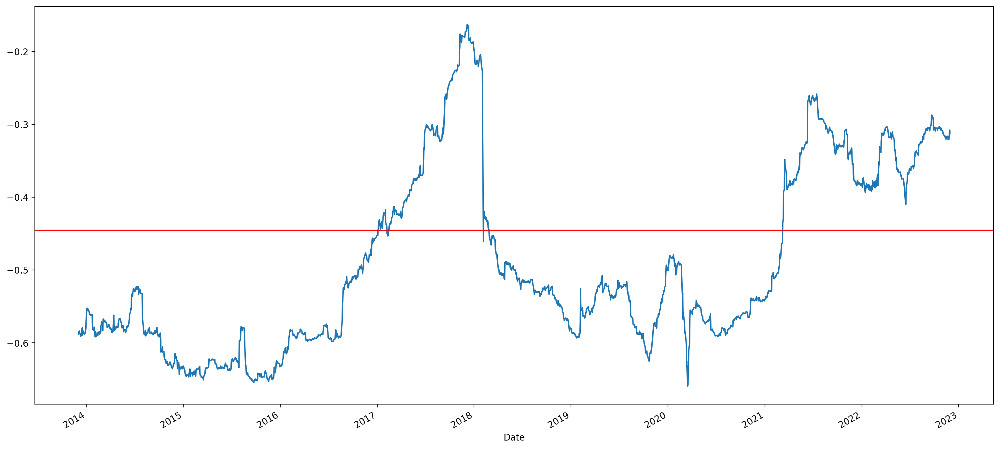

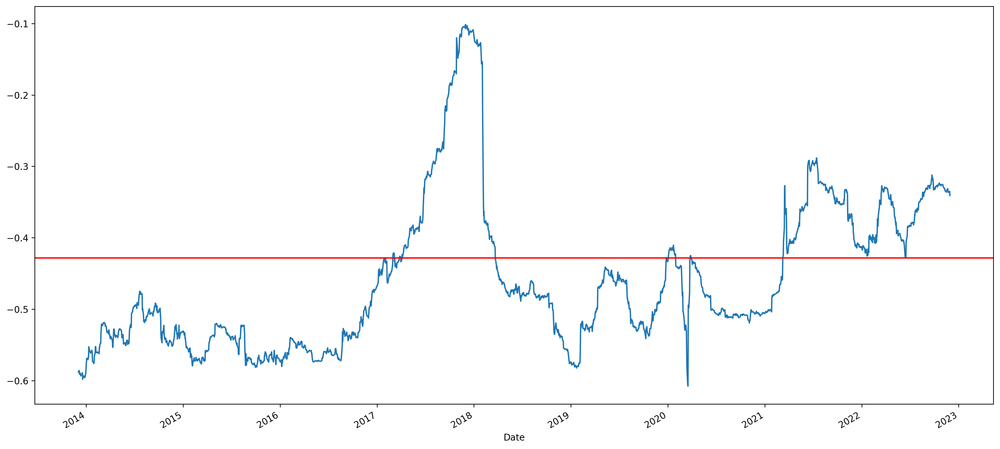

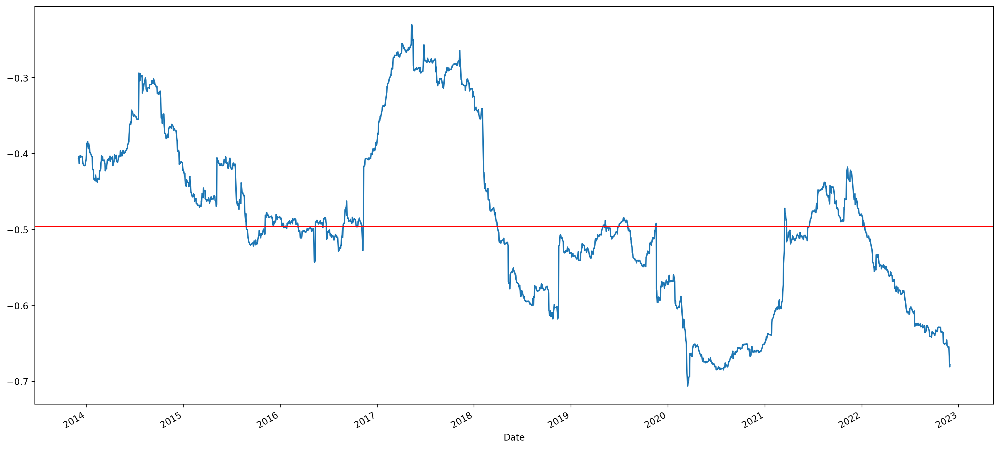

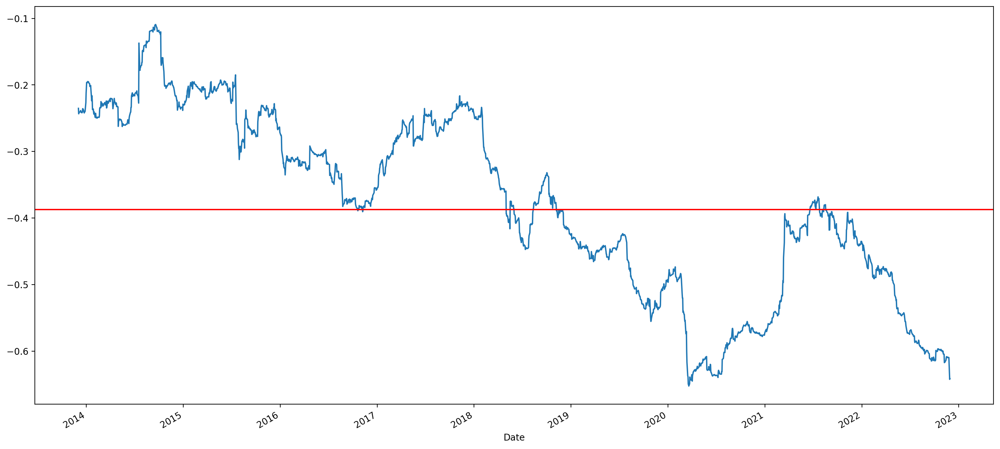

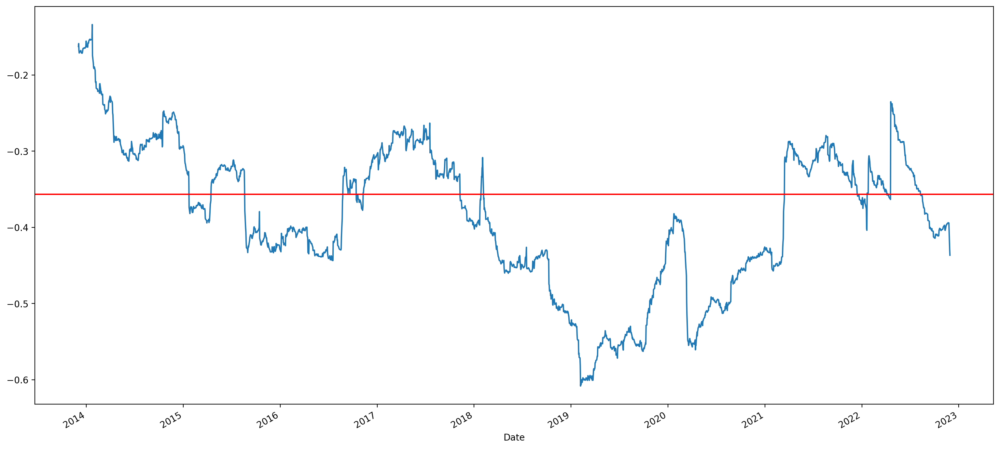

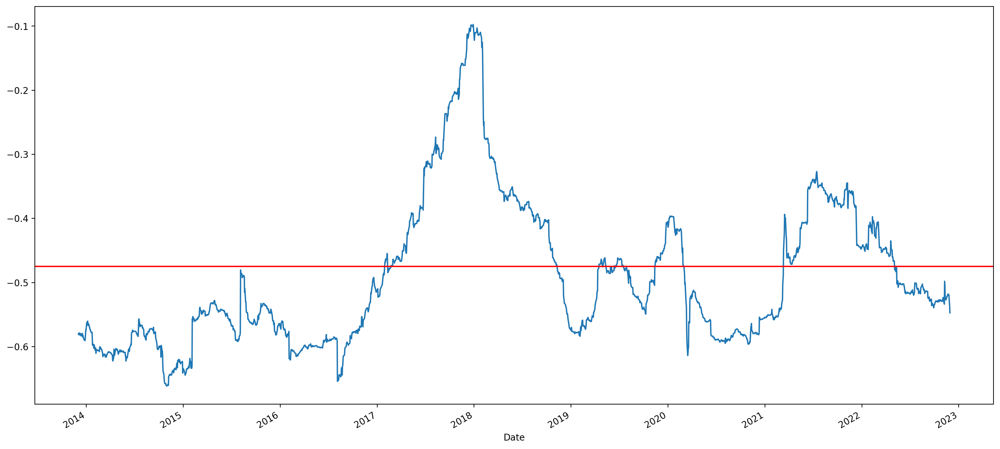

In [33]:
for stock in stocksString:
    plt.figure()
    ax = vixLog['Adj Close_'+stock].rolling(window=252).corr(vixLog['Adj Close_VIX']).plot(figsize=(19,9))
    ax.axhline(vixLog[['Adj Close_'+stock, 'Adj Close_VIX']].corr().iloc[0,1], c='r')

## CAPM

### Beta

In [34]:
beta = capmBeta(closeMonthly, market, stocksString)
beta

{'EXXONMOBIL': 1.0742629243326585,
 'CHEVRON': 1.2075009287416212,
 'NVIDIA': 1.6061261254873422,
 'AMD': 2.064928453495433,
 'NETFLIX': 1.3127338236947337,
 'DISNEY': 1.2678713000463795}

### Fama - French

In [35]:
stringa = ' Annual Factors: January-December '
indices = frenchFactor.iloc[:,0] == stringa
startAnnual = frenchFactor[indices].index[0]
frenchFactor2 = frenchFactor[frenchFactor.index < startAnnual]
frenchFactor2.columns = ['data', 'mkt', 'smb', 'hml', 'rf']
frenchFactor2['data'] = pd.to_datetime(frenchFactor2['data'], format='%Y%m').dt.strftime("%Y-%m")
frenchFactor2 = frenchFactor2.set_index('data')
frenchFactor2 = frenchFactor2[startDate:endDate]
frenchFactor2 = frenchFactor2.apply(pd.to_numeric, errors='coerce').div(100)
frenchFactor2

,mkt,smb,hml,rf
data,,,,
2012-12,0.0118,0.0150,0.0351,0.0001
2013-01,0.0557,0.0033,0.0096,0.0000
2013-02,0.0129,-0.0028,0.0011,0.0000
2013-03,0.0403,0.0081,-0.0019,0.0000
2013-04,0.0155,-0.0236,0.0045,0.0000
...,...,...,...,...
2022-06,-0.0843,0.0209,-0.0597,0.0006
2022-07,0.0957,0.0281,-0.0410,0.0008
2022-08,-0.0377,0.0139,0.0031,0.0019


In [36]:
simpleReturnMontly = removeNameColumns(stocks, "Adj Close", stocksString)
simpleReturnMontly = simpleReturnMontly.groupby(pd.Grouper(freq='M')).last().pct_change().dropna()
simpleReturnMontly.index = simpleReturnMontly.index.strftime('%Y-%m')
simpleReturnMontly

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Date,,,,,,
2012-12,-0.018039,0.023181,0.024228,0.090909,0.133154,0.018014
2013-01,0.039515,0.064824,0.000000,0.083333,0.784642,0.082145
2013-02,0.001691,0.025289,0.038961,-0.042308,0.138223,0.013178
2013-03,0.006253,0.014255,0.013428,0.024096,0.006380,0.040484
2013-04,-0.012429,0.026847,0.073266,0.105882,0.141536,0.106338
...,...,...,...,...,...,...
2022-07,0.131831,0.131234,0.198166,0.235386,0.286098,0.123941
2022-08,-0.004242,-0.026156,-0.168970,-0.101620,-0.005958,0.056362
2022-09,-0.086620,-0.091041,-0.195534,-0.253446,0.053140,-0.158369


In [37]:
ffDF = frenchFactor2.join(simpleReturnMontly)
for stock in stocksString:
    ffDF["excessReturn"+stock] = ffDF[stock] - ffDF.rf
ffDF

,mkt,smb,hml,rf,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY,excessReturnEXXONMOBIL,excessReturnCHEVRON,excessReturnNVIDIA,excessReturnAMD,excessReturnNETFLIX,excessReturnDISNEY
data,,,,,,,,,,,,,,,,
2012-12,0.0118,0.0150,0.0351,0.0001,-0.018039,0.023181,0.024228,0.090909,0.133154,0.018014,-0.018139,0.023081,0.024128,0.090809,0.133054,0.017914
2013-01,0.0557,0.0033,0.0096,0.0000,0.039515,0.064824,0.000000,0.083333,0.784642,0.082145,0.039515,0.064824,0.000000,0.083333,0.784642,0.082145
2013-02,0.0129,-0.0028,0.0011,0.0000,0.001691,0.025289,0.038961,-0.042308,0.138223,0.013178,0.001691,0.025289,0.038961,-0.042308,0.138223,0.013178
2013-03,0.0403,0.0081,-0.0019,0.0000,0.006253,0.014255,0.013428,0.024096,0.006380,0.040484,0.006253,0.014255,0.013428,0.024096,0.006380,0.040484
2013-04,0.0155,-0.0236,0.0045,0.0000,-0.012429,0.026847,0.073266,0.105882,0.141536,0.106338,-0.012429,0.026847,0.073266,0.105882,0.141536,0.106338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06,-0.0843,0.0209,-0.0597,0.0006,-0.107917,-0.171075,-0.187971,-0.249264,-0.114313,-0.145237,-0.108517,-0.171675,-0.188571,-0.249864,-0.114913,-0.145837
2022-07,0.0957,0.0281,-0.0410,0.0008,0.131831,0.131234,0.198166,0.235386,0.286098,0.123941,0.131031,0.130434,0.197366,0.234586,0.285298,0.123141
2022-08,-0.0377,0.0139,0.0031,0.0019,-0.004242,-0.026156,-0.168970,-0.101620,-0.005958,0.056362,-0.006142,-0.028056,-0.170870,-0.103520,-0.007858,0.054462


In [38]:
for stock in stocksString:
    ffModel = smf.ols(formula = 'excessReturn'+stock+' ~ mkt + smb + hml', data = ffDF).fit()
    print(ffModel.summary())

                              OLS Regression Results                              
Dep. Variable:     excessReturnEXXONMOBIL   R-squared:                       0.603
Model:                                OLS   Adj. R-squared:                  0.593
Method:                     Least Squares   F-statistic:                     58.21
Date:                    Sun, 15 Jan 2023   Prob (F-statistic):           5.76e-23
Time:                            14:14:25   Log-Likelihood:                 191.29
No. Observations:                     119   AIC:                            -374.6
Df Residuals:                         115   BIC:                            -363.5
Df Model:                               3                                         
Covariance Type:                nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   

In [39]:
vixString = createvixString(stocksString)
vixAsset = createAdjCloseVixAsset(vix, stocks, vixString)

array([<AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>, <AxesSubplot: xlabel='Date'>,
       <AxesSubplot: xlabel='Date'>], dtype=object)

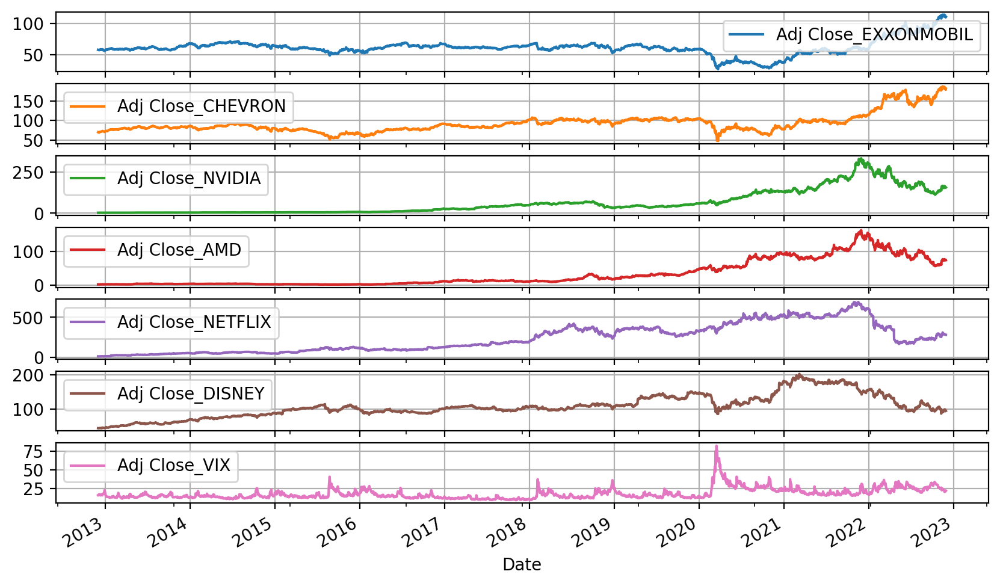

In [40]:
vixAsset.plot(subplots=True, figsize=(10,6), grid = True)

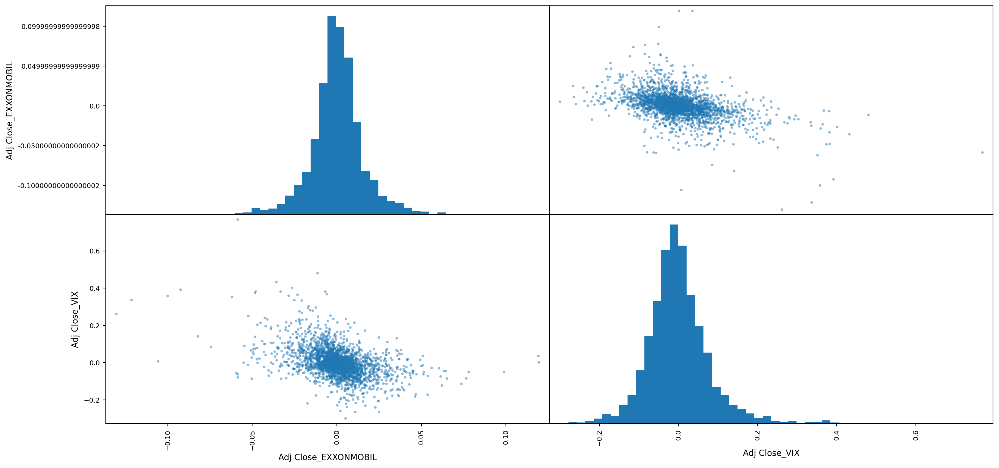

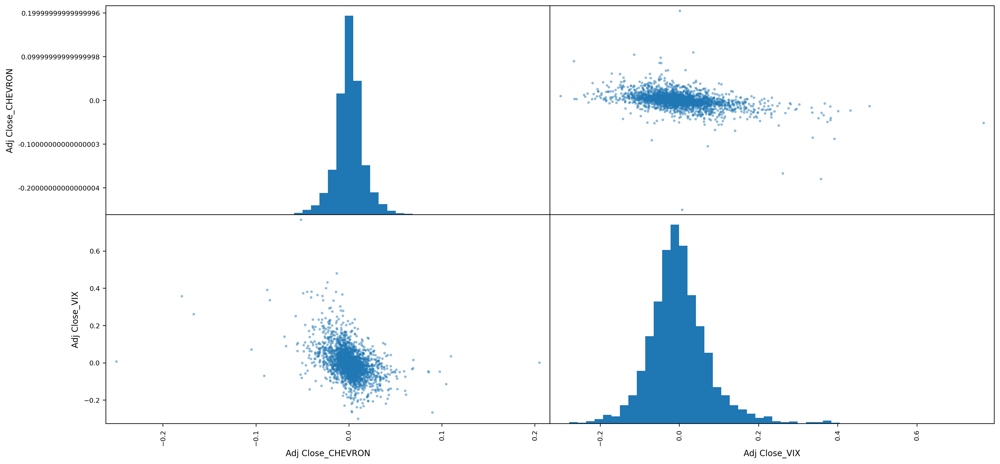

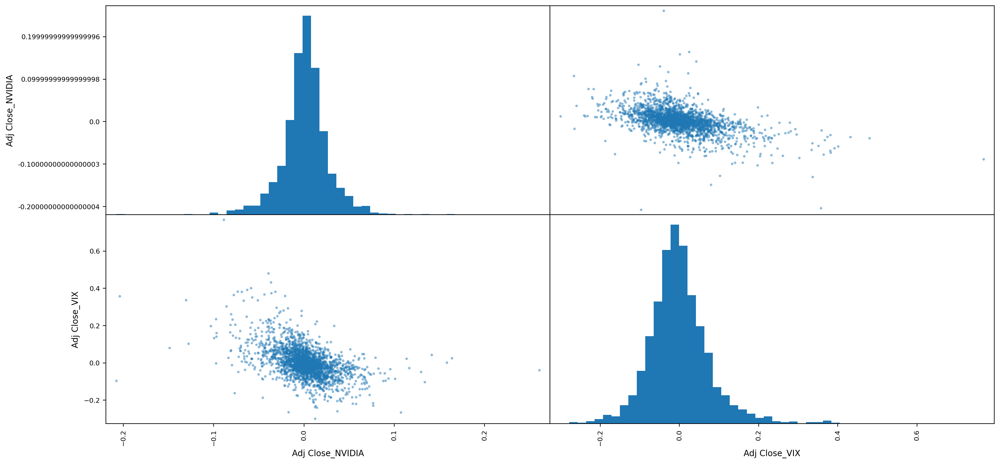

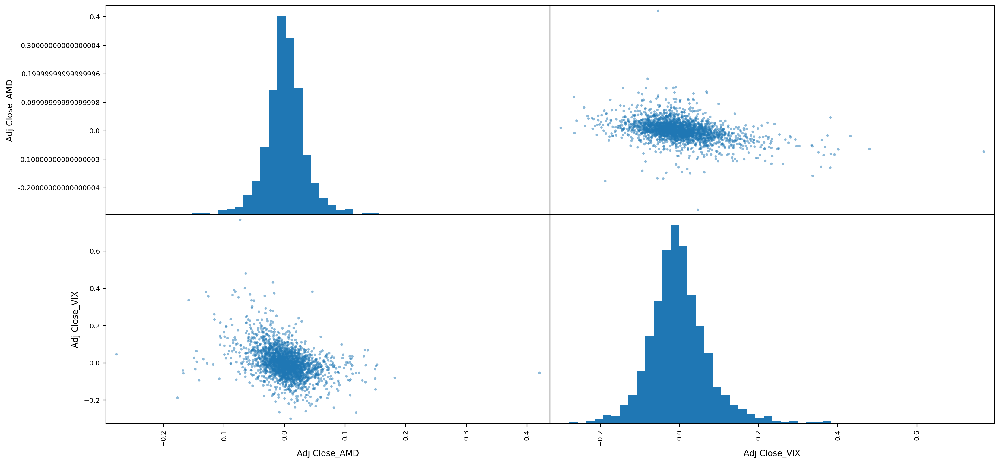

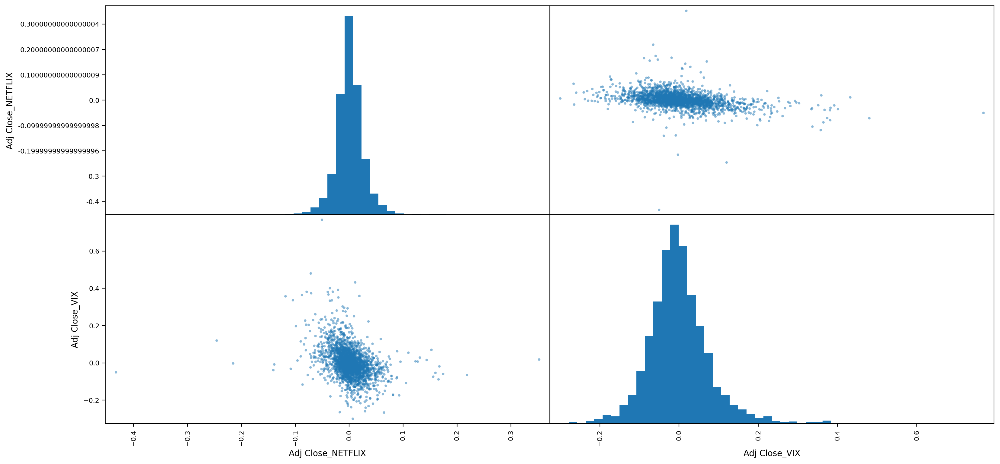

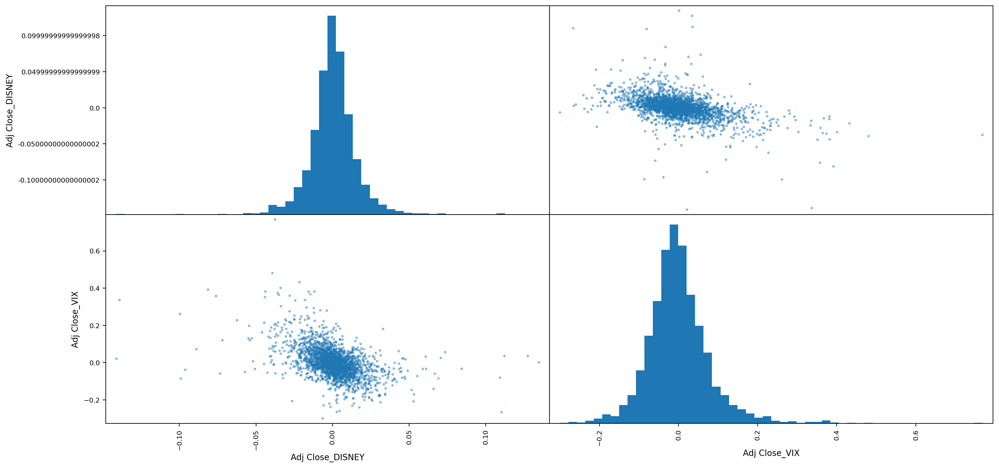

In [41]:
vixLog = np.log(vixAsset / vixAsset.shift(1))
createVixGraph(vixLog, stocksString)

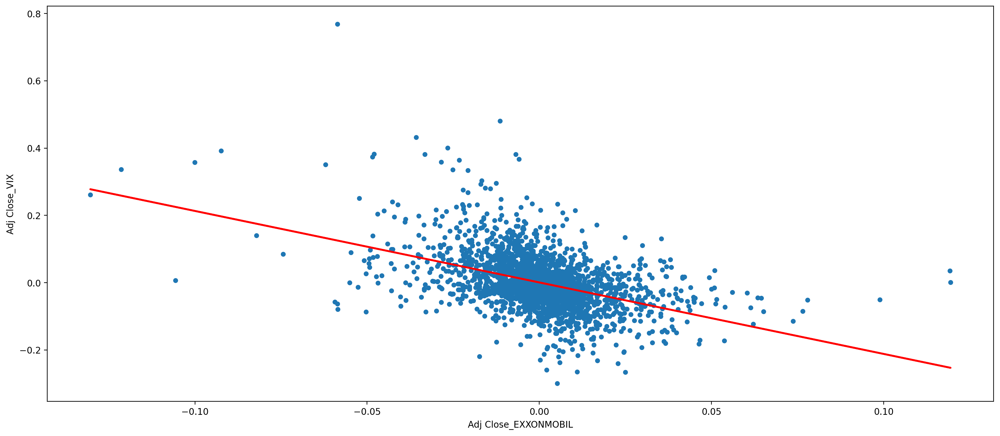

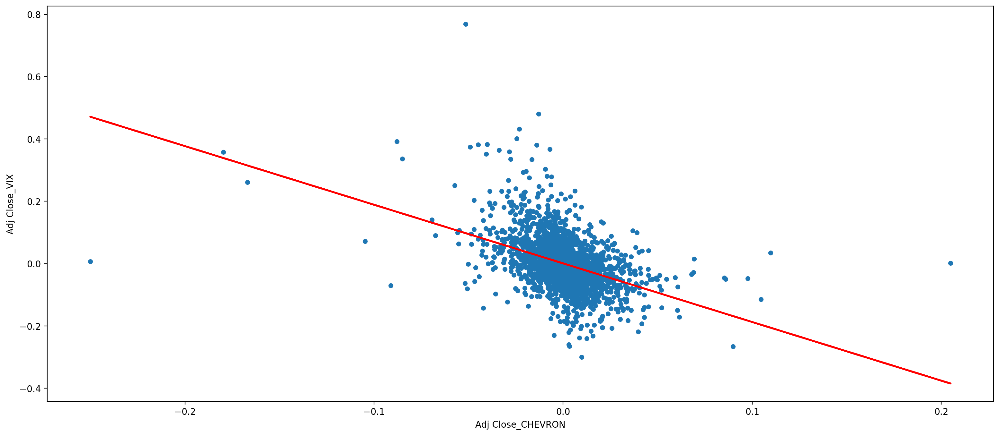

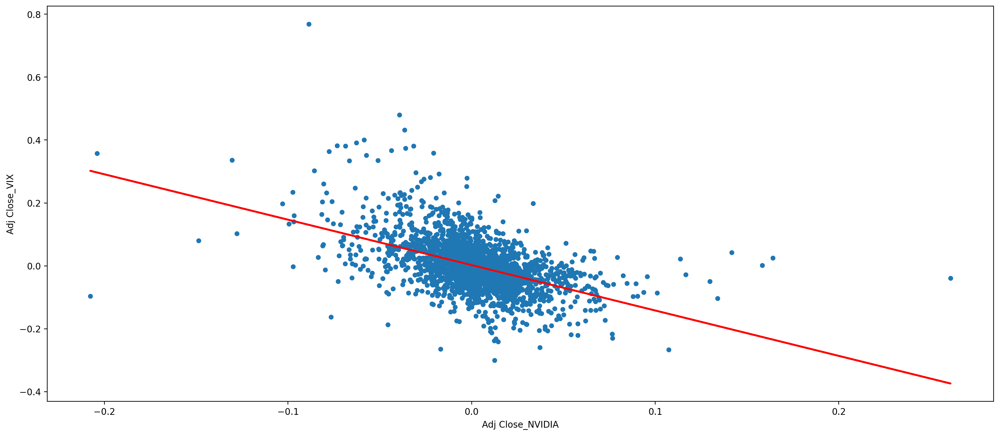

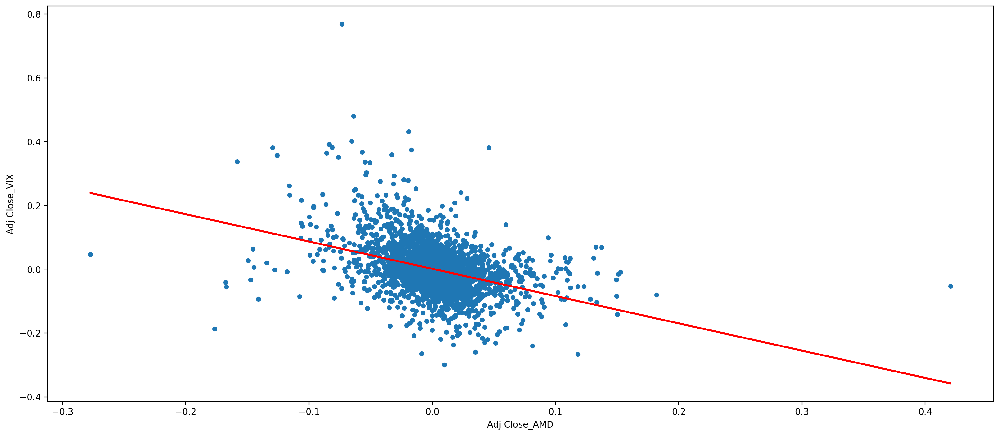

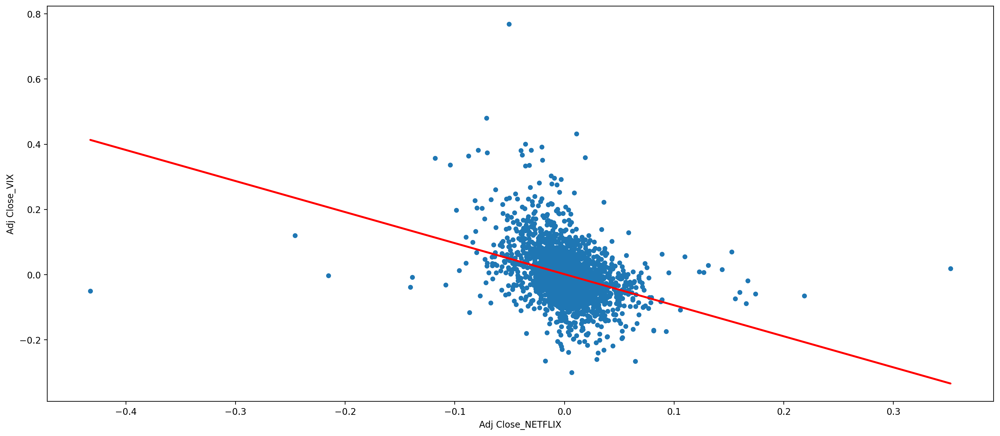

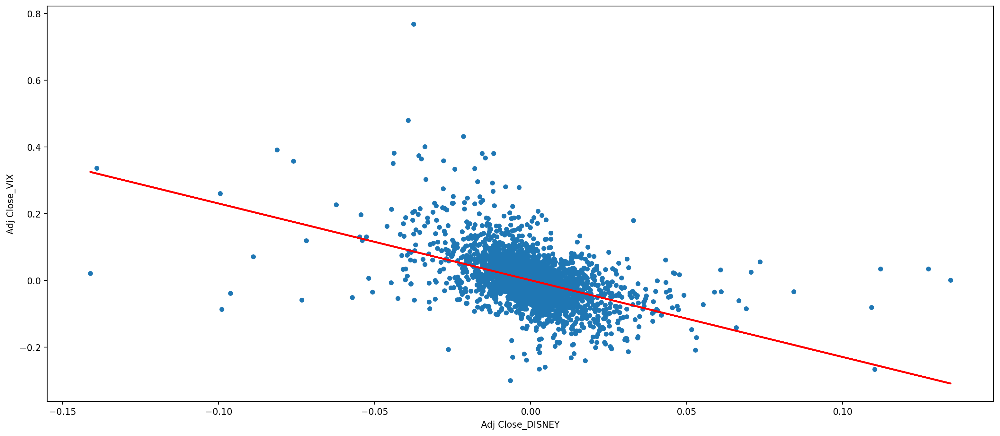

In [42]:
createScatterPlotVix(vixLog, stocksString)

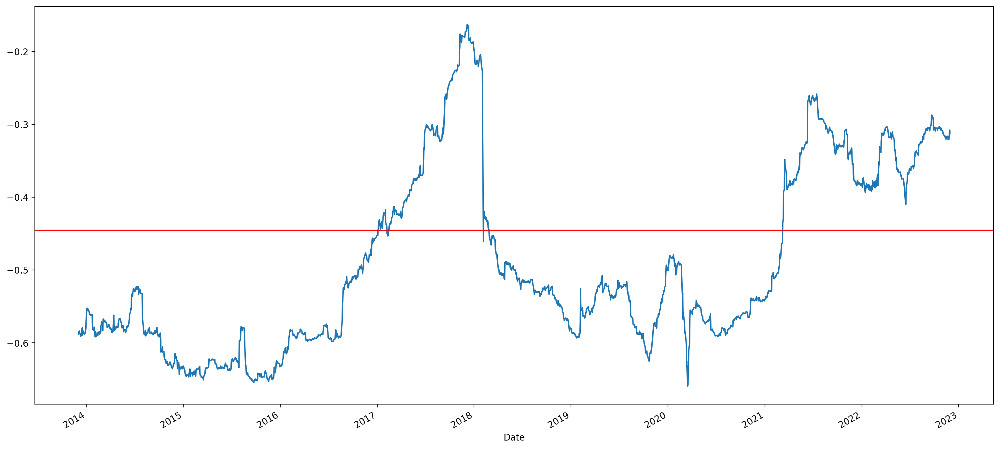

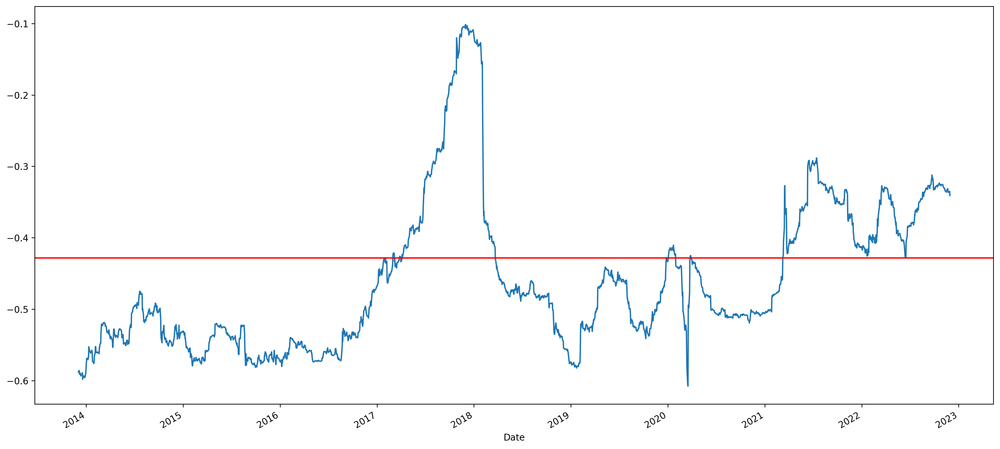

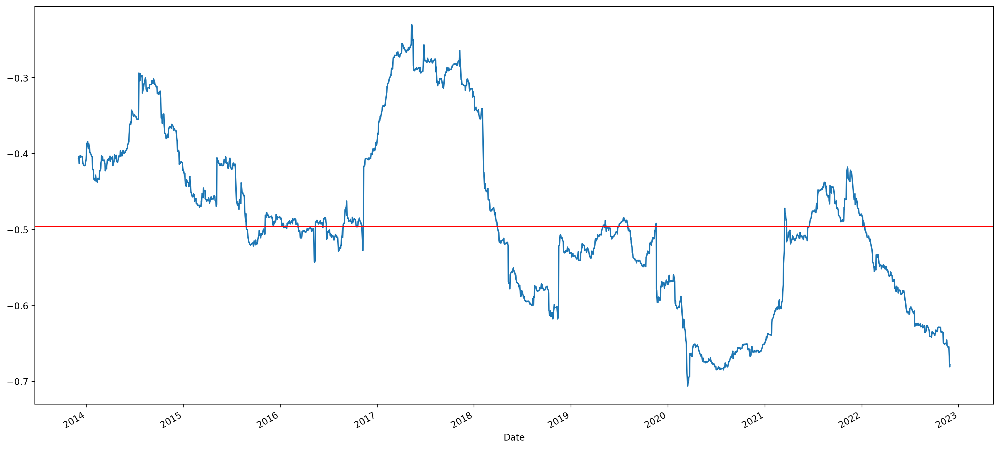

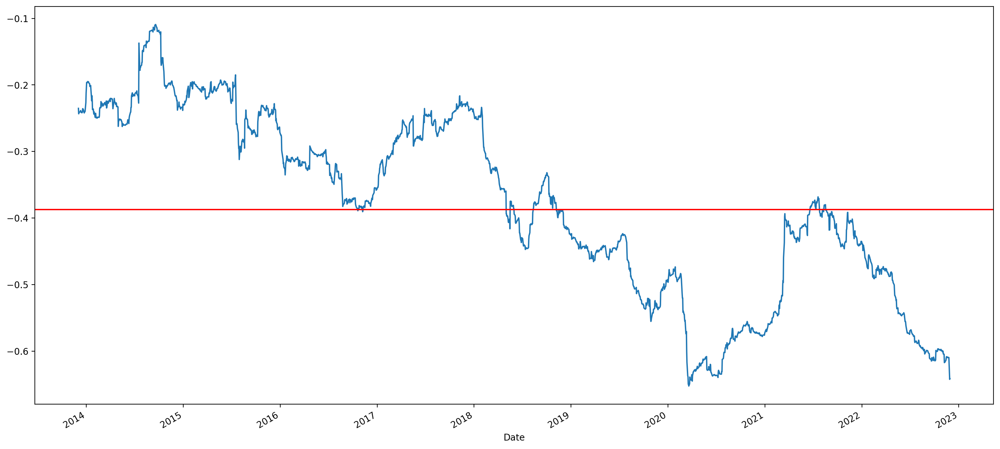

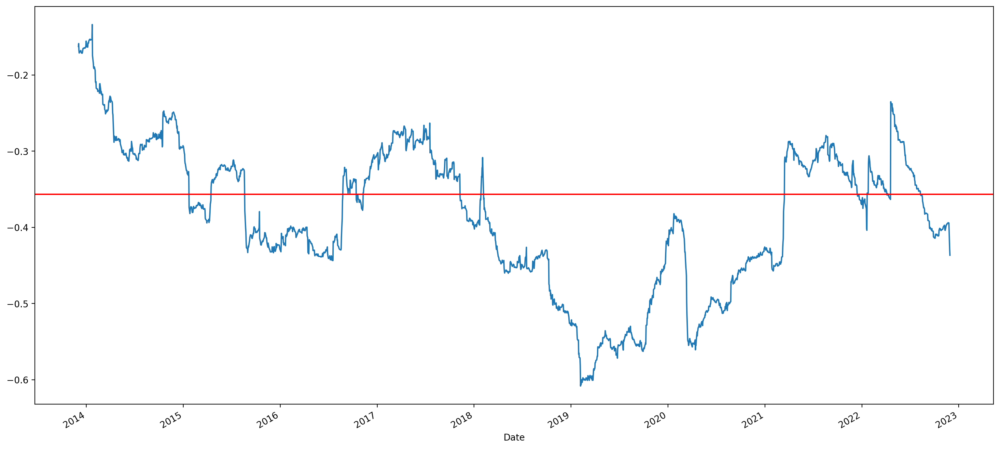

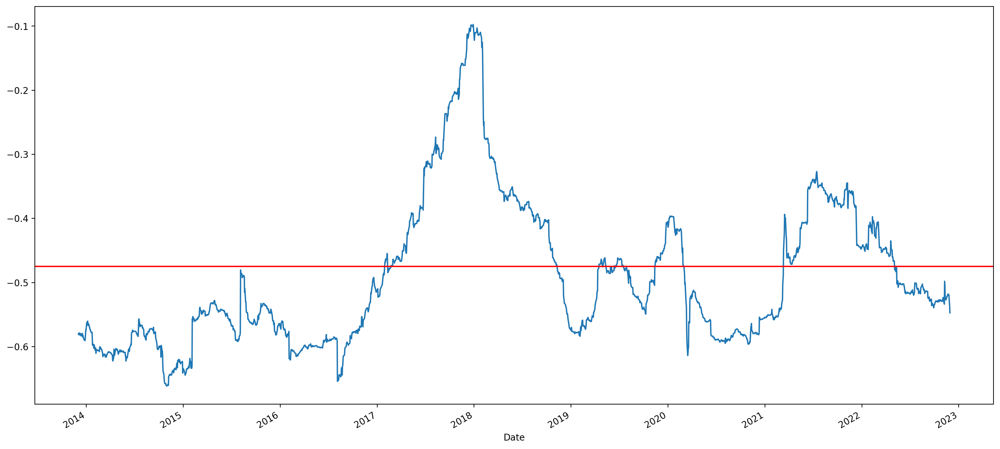

In [43]:
for stock in stocksString:
    plt.figure()
    ax = vixLog['Adj Close_'+stock].rolling(window=252).corr(vixLog['Adj Close_VIX']).plot(figsize=(19,9))
    ax.axhline(vixLog[['Adj Close_'+stock, 'Adj Close_VIX']].corr().iloc[0,1], c='r')

### Prediction with Beta

In [44]:
betaDf = pd.DataFrame(beta, columns = stocksString, index = ["BETA"])
for stock in betaDf:
    b = round(betaDf[stock][0], 4)
    if b < 0:
        print(stock.rjust(10)+"  "+str(b).rjust(10)+"  "+stock+" moves in the opposite direction of the movement of the market ^GSPC")    
    elif b == 0:
        print(stock.rjust(10)+"  "+str(b).rjust(10)+"  "+"Movements of the "+stock+" and the market ^GSPC are uncorrelated")   
    elif b > 0 and b < 1:
        print(stock.rjust(10)+"  "+str(b).rjust(10)+"  "+stock+" moves in the same direction as the market ^GSPC")
    else:
        print(stock.rjust(10)+"  "+str(b).rjust(10)+"  "+stock+" moves in the same direction as the market ^GSPC with greater volatility")   

EXXONMOBIL      1.0743  EXXONMOBIL moves in the same direction as the market ^GSPC with greater volatility
   CHEVRON      1.2075  CHEVRON moves in the same direction as the market ^GSPC with greater volatility
    NVIDIA      1.6061  NVIDIA moves in the same direction as the market ^GSPC with greater volatility
       AMD      2.0649  AMD moves in the same direction as the market ^GSPC with greater volatility
   NETFLIX      1.3127  NETFLIX moves in the same direction as the market ^GSPC with greater volatility
    DISNEY      1.2679  DISNEY moves in the same direction as the market ^GSPC with greater volatility


In [45]:
marketReturn = market.drop(columns = ["Open", "High", "Low", "Close", "Volume"])
marketReturn = marketReturn.groupby(pd.Grouper(freq='Y')).last()
marketReturn = marketReturn.rename(columns={"Adj Close":"^GSPC"})
marketReturn = marketReturn/marketReturn.shift(1)
marketReturn = marketReturn.dropna()
marketMean = marketReturn.mean()-1

In [46]:
expectedReturn = pd.DataFrame([], columns = stocksString)
for stock in stocksString:
    expectedReturn[stock] = rf + betaDf[stock][0]*(marketMean-rf)
expectedReturn.index = ["Exp_Return"]
expectedReturn

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
Exp_Return,0.12533,0.138394,0.177478,0.222463,0.148711,0.144313


## Portfolio construction

### Portfolio optimization with historical returns

In [47]:
numberPortfolios = 100000
simpleReturnMontlyMeans = simpleReturnMontly.head(108).mean() * 12
simpleReturnMontlyMeans

EXXONMOBIL    0.028799
CHEVRON       0.078630
NVIDIA        0.611337
AMD           0.623234
NETFLIX       0.542804
DISNEY        0.160410
dtype: float64

In [48]:
covarianceMatrix = simpleReturnMontly.cov()*12
covarianceMatrix

,EXXONMOBIL,CHEVRON,NVIDIA,AMD,NETFLIX,DISNEY
EXXONMOBIL,0.070907,0.062128,0.022282,0.028650,0.011000,0.032252
CHEVRON,0.062128,0.072000,0.027763,0.047096,0.018970,0.034484
NVIDIA,0.022282,0.027763,0.172648,0.118525,0.074329,0.021769
AMD,0.028650,0.047096,0.118525,0.312581,0.066882,0.043471
NETFLIX,0.011000,0.018970,0.074329,0.066882,0.243347,0.042311
DISNEY,0.032252,0.034484,0.021769,0.043471,0.042311,0.068662


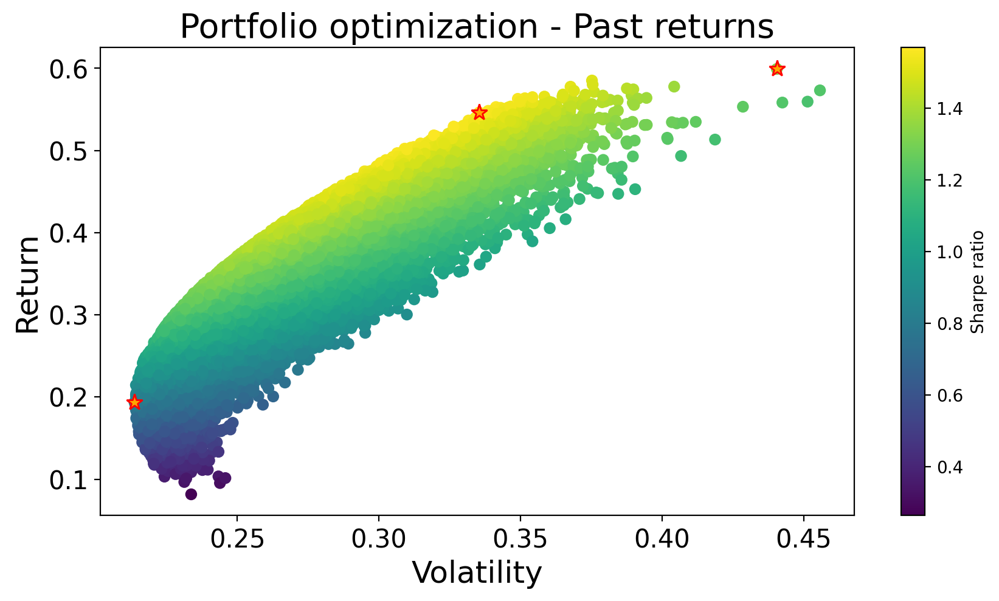

In [49]:
portfolioRisks, portfolioReturns, minRiskPastReturn, highestReturnPastReturn, highestSharpePastReturn = createPortfolioReturn(simpleReturnMontly, simpleReturnMontlyMeans, covarianceMatrix, numberPortfolios, rf)
createPortfolioReturnPlot(portfolioRisks, portfolioReturns, rf, "Past", minRiskPastReturn, highestReturnPastReturn, highestSharpePastReturn)

In [50]:
print('Lowest risk')
print(minRiskPastReturn)

print('')

print('Highest return')
print(highestReturnPastReturn)

print('')
      
print('Highest Sharpe ratio')
print(highestSharpePastReturn)

print('')

Lowest risk
Return                                       0.193588
Risk                                         0.213737
Sharpe                                       0.812158
Weights    [0.348, 0.069, 0.125, 0.007, 0.065, 0.387]
Name: 74754, dtype: object

Highest return
Return                                      0.599141
Risk                                        0.440525
Sharpe                                      1.314662
Weights    [0.006, 0.007, 0.218, 0.66, 0.095, 0.014]
Name: 6304, dtype: object

Highest Sharpe ratio
Return                                       0.54614
Risk                                        0.335423
Sharpe                                      1.568588
Weights    [0.003, 0.033, 0.486, 0.127, 0.29, 0.061]
Name: 2737, dtype: object



### Portfolio optimization with expected returns

In [51]:
simpleReturnMontlyMeans = simpleReturnMontly.head(108).mean() * 12
meansLastItem = dict()
expectedReturn = dict()

for stock in stocksString:
    meansLastItem[stock] = float((predCi[stock].tail(1)["lower "+stock] + predCi[stock].tail(1)["upper "+stock])/2)
    expectedReturn[stock] = float(meansLastItem[stock]/(closeMonthly.head(108).tail(1)[stock]))-1

meansExpectedReturn = pd.Series(expectedReturn)

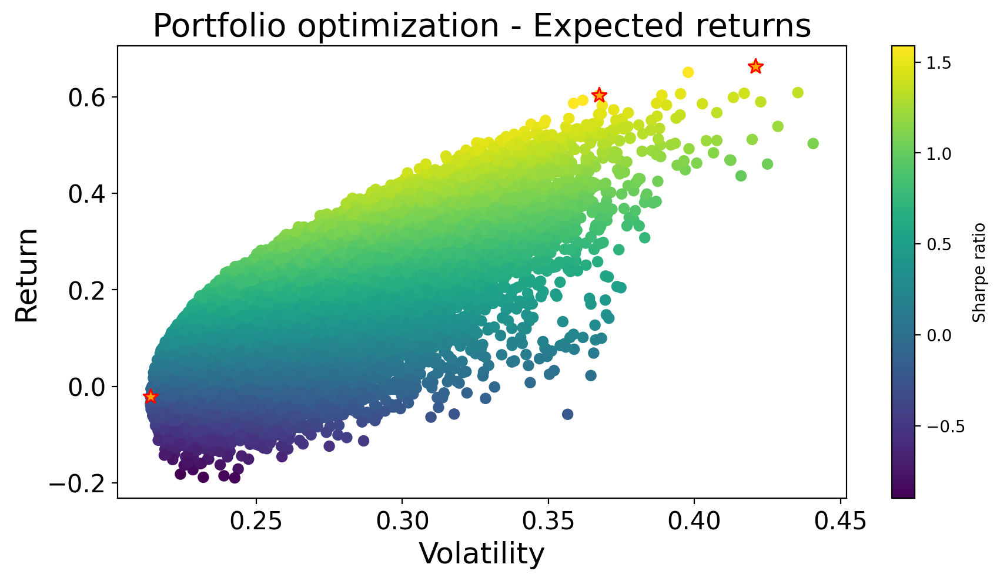

In [52]:
portfolioRisks, portfolioReturns, minRiskExpectedReturn, highestReturnExpectedReturn, highestSharpeExpectedReturn = createPortfolioReturn(simpleReturnMontly, meansExpectedReturn, covarianceMatrix, numberPortfolios, rf)
createPortfolioReturnPlot(portfolioRisks, portfolioReturns, rf, "Expected", minRiskExpectedReturn, highestReturnExpectedReturn, highestSharpeExpectedReturn)

In [53]:
print('Lowest risk')
print(minRiskExpectedReturn)

print('')

print('Highest return')
print(highestReturnExpectedReturn)

print('')
      
print('Highest Sharpe ratio')
print(highestSharpeExpectedReturn)

print('')

Lowest risk
Return                                   -0.020748
Risk                                      0.213775
Sharpe                                   -0.190611
Weights    [0.392, 0.009, 0.155, 0.0, 0.064, 0.38]
Name: 63531, dtype: object

Highest return
Return                                     0.662281
Risk                                       0.420981
Sharpe                                     1.525676
Weights    [0.01, 0.03, 0.399, 0.548, 0.006, 0.006]
Name: 3534, dtype: object

Highest Sharpe ratio
Return                                       0.603309
Risk                                         0.367344
Sharpe                                       1.587909
Weights    [0.047, 0.016, 0.622, 0.265, 0.014, 0.035]
Name: 22320, dtype: object



### Portfolio's beta

In [54]:
betaPortfolioExpectedReturn, betaPortfolioPastReturn = 0, 0

for i in  range(len(stocksString)):
    a = highestReturnPastReturn.Weights[i] * beta[stocksString[i]]
    b = highestReturnExpectedReturn.Weights[i] * beta[stocksString[i]]
    betaPortfolioPastReturn += a 
    betaPortfolioExpectedReturn += b

print("Beta portfolio highest return with past return : "+ str(betaPortfolioPastReturn))
print("Beta portfolio highest return with expected return : "+ str(betaPortfolioExpectedReturn))

Beta portfolio highest return with past return : 1.8703462701620628
Beta portfolio highest return with expected return : 1.8348764044329686


### Comparison

In [55]:
weightPortfolioPastReturn = highestReturnPastReturn.Weights
weightPortfolioExpectedReturn = highestReturnExpectedReturn.Weights
returnPortfolioPastReturn, returnPortfolioExpectedReturn, returnPortfolioEffetiveReturn = 0, 0, 0

for i in  range(len(stocksString)):
    r = (closeMonthly.tail(1)[stocksString[i]] / closeMonthly.iloc[108, i])
    returnPortfolioPastReturn += float(r * weightPortfolioPastReturn[i])
    returnPortfolioExpectedReturn += float(r * weightPortfolioExpectedReturn[i])
    returnPortfolioEffetiveReturn += float(r * 0.1666667)

print("Return portfolio with highest return based past return : ",+float(returnPortfolioPastReturn-1)) 
print("Return portfolio with highest return based expected return : ",+float(returnPortfolioExpectedReturn-1))
print("Return portfolio with highest return based effective return : ",+float(returnPortfolioEffetiveReturn-1))

Return portfolio with highest return based past return :  -0.5158450074218087
Return portfolio with highest return based expected return :  -0.4793322355959694
Return portfolio with highest return based effective return :  -0.06403620298107582
